In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# GPU Information in the PC

In [ ]:
!nvidia-smi

Tue Nov  7 12:09:22 2023       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 537.58                 Driver Version: 537.58       CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                     TCC/WDDM  | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce GTX 1070 Ti   WDDM  | 00000000:01:00.0  On |                  N/A |
|  0%   41C    P8              12W / 180W |   1942MiB /  8192MiB |      3%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
import torch
torch.cuda.is_available()

True

# Installing Ultralytics Package

In [ ]:
#!pip install ultralytics==8.0.20
# pip install --upgrade ultralytics
# pip install ultralytics


# Importing Required Libraries

In [ ]:
## importing required libraries
import os
import shutil
import random
from IPython import display
display.clear_output()

from ultralytics import YOLO

from IPython.display import display, Image

!pip install tqdm --upgrade
from tqdm.notebook import tqdm

In [ ]:
from IPython.display import Video
from PIL import Image

import csv
import matplotlib.pyplot as plt
import numpy as np

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.203  Python-3.8.18 torch-2.1.0 CUDA:0 (NVIDIA GeForce GTX 1070 Ti, 8192MiB)
Setup complete  (8 CPUs, 63.8 GB RAM, 192.9/237.4 GB disk)


In [ ]:
import tensorflow as tf

## Setting the file paths for different directories in the project


In [ ]:
testing_images_path = r".\test_images"
training_results_path = r".\training_results"
testing_videos_path = r".\videos"
data_yaml_path = r".\dataset.yaml"


In [ ]:
tf.keras.utils.image_dataset_from_directory(".\data")

Found 2801 files belonging to 2 classes.


<_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

# YOLO Training Process Overview

##### This model underwent training over a span of 50 epochs, marking a pivotal stage in its evolution and improvement.


In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO('yolov8s.pt')

# Train the model
model.train(data=data_yaml_path, epochs=100, imgsz=640, batch=8, project=training_results_path, name='Construction_Site_Safety', plots=True, device=0)

New https://pypi.org/project/ultralytics/8.0.207 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.203  Python-3.8.18 torch-2.1.0 CUDA:0 (NVIDIA GeForce GTX 1070 Ti, 8192MiB)
engine\trainer: task=detect, mode=train, model=yolov8s.pt, data=.\dataset.yaml, epochs=100, patience=50, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=.\training_results, name=Construction_Site_Safety3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visual

      5/100      2.51G      1.177      1.295      1.329         91        640: 100%|██████████| 336/336 [01:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0
                   all        114        697      0.755      0.543      0.618      0.322

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      6/100      2.25G       1.15      1.233      1.312        191        640: 100%|██████████| 336/336 [01:26<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0
                   all        114        697      0.751      0.581      0.644      0.331

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      7/100      2.24G      1.125      1.193      1.299        103        640: 100%|██████████| 336/336 [01:25<00:00,  
                 Class     Images  Instances      Box(P         

     25/100      2.26G     0.9182     0.8023      1.154        172        640: 100%|██████████| 336/336 [01:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0
                   all        114        697      0.827      0.729      0.791      0.482

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     26/100      2.26G      0.907     0.7853      1.145        144        640: 100%|██████████| 336/336 [01:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0
                   all        114        697      0.841       0.73      0.789      0.485

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     27/100      2.34G     0.9068     0.7753      1.141        128        640: 100%|██████████| 336/336 [01:25<00:00,  
                 Class     Images  Instances      Box(P         

     45/100      2.38G     0.8032     0.6377      1.073         98        640: 100%|██████████| 336/336 [01:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0
                   all        114        697       0.87      0.759      0.823      0.539

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     46/100      2.29G     0.8013     0.6513      1.077        178        640: 100%|██████████| 336/336 [01:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0
                   all        114        697      0.918      0.749      0.822      0.543

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     47/100      2.35G     0.7976     0.6333      1.069        174        640: 100%|██████████| 336/336 [01:25<00:00,  
                 Class     Images  Instances      Box(P         

     65/100      2.37G     0.7223     0.5509      1.027        164        640: 100%|██████████| 336/336 [01:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0
                   all        114        697      0.927      0.775      0.849      0.576

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     66/100      2.24G      0.721     0.5508      1.029         90        640: 100%|██████████| 336/336 [01:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0
                   all        114        697      0.918      0.776      0.851      0.586

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     67/100      2.34G     0.7038     0.5386      1.021        118        640: 100%|██████████| 336/336 [01:25<00:00,  
                 Class     Images  Instances      Box(P         

     85/100      2.23G     0.6492     0.4872     0.9909         98        640: 100%|██████████| 336/336 [01:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0
                   all        114        697      0.918      0.781      0.854      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     86/100      2.25G     0.6359     0.4787     0.9852        184        640: 100%|██████████| 336/336 [01:25<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0
                   all        114        697      0.945      0.765      0.852      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     87/100      2.23G      0.642     0.4854       0.99        157        640: 100%|██████████| 336/336 [01:25<00:00,  
                 Class     Images  Instances      Box(P         

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001F82D86A9A0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,   

## Confusion Matrix Visualization


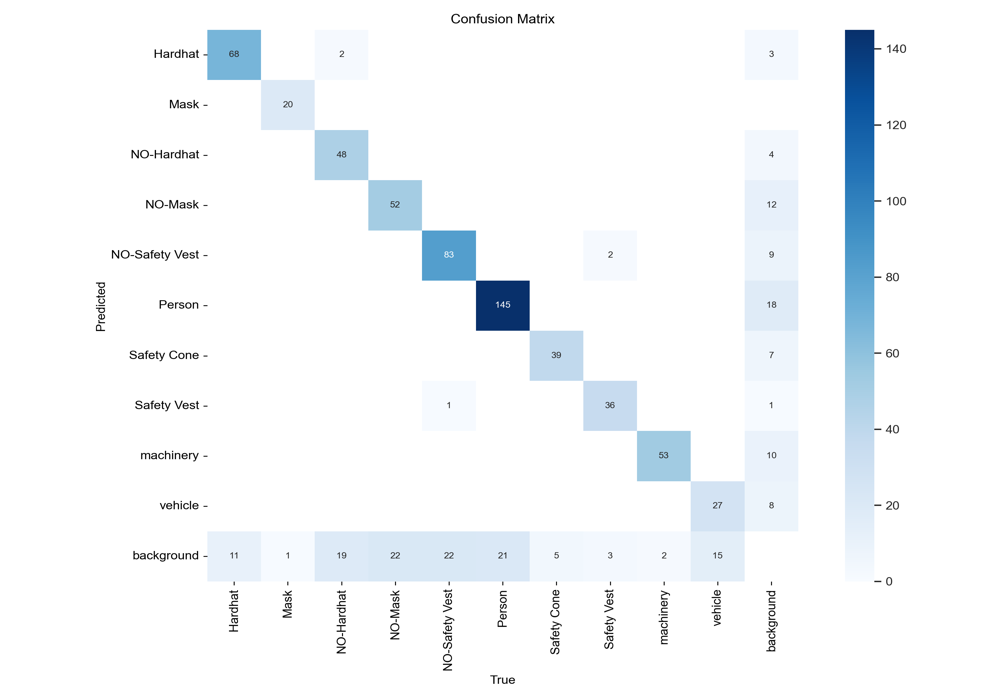

In [ ]:
# Get the directory path
directory_path = r".\training_results\Construction_Site_Safety3"

first_png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][0]

# Convert the PNG image to the RGB mode
rgb_image = Image.open(os.path.join(directory_path, first_png_image)).convert("RGB").resize((1000, 700))

# Display the PNG image
display(rgb_image)


# Normalized Confusion Matrix


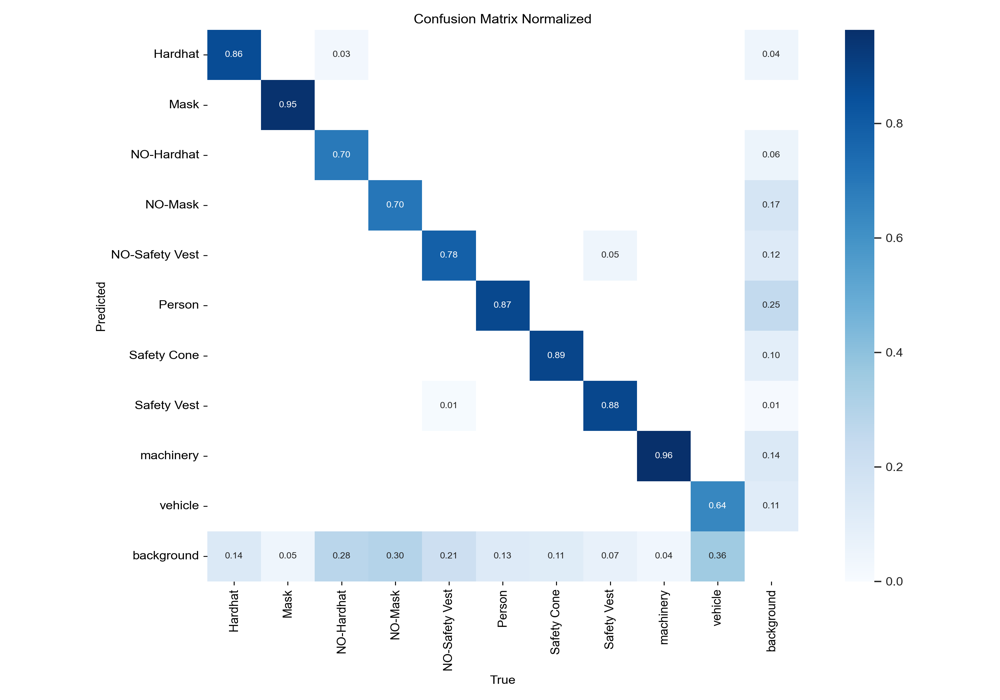

In [ ]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][1]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)


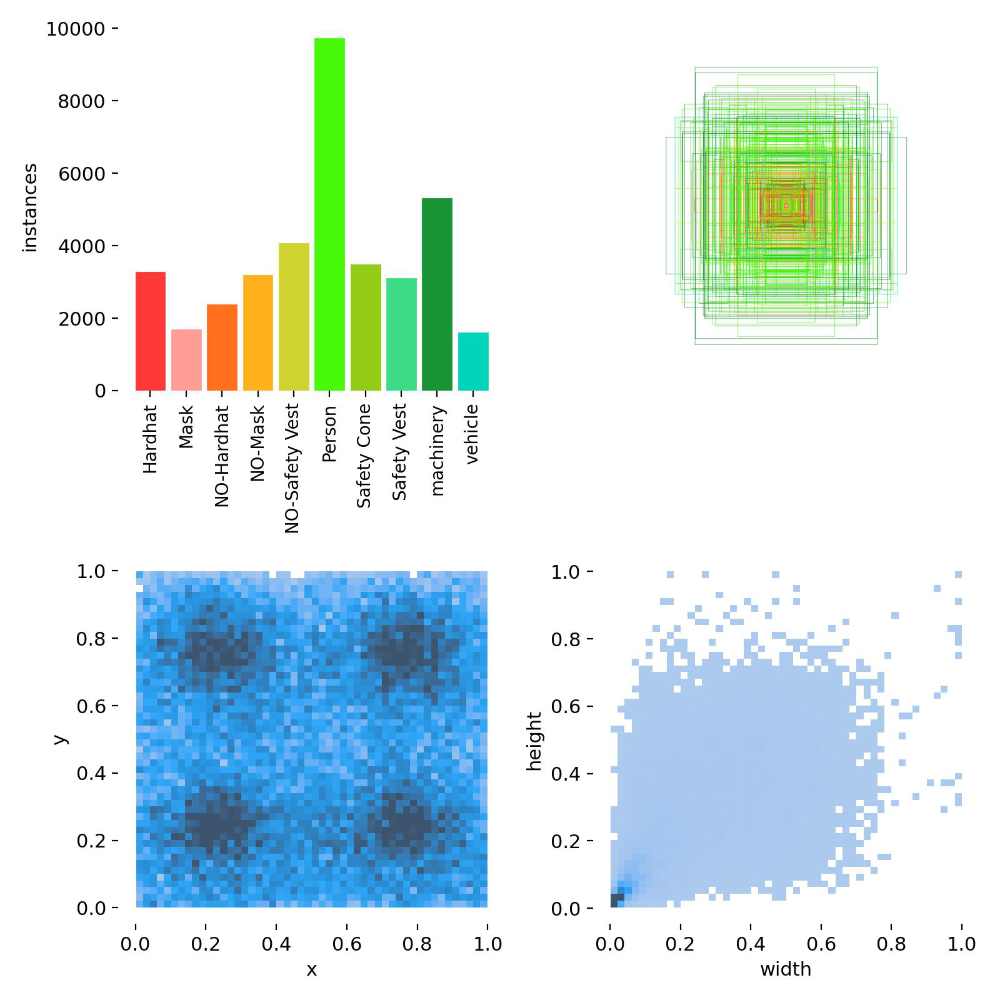

In [ ]:
images = [f for f in os.listdir(directory_path) if f.endswith(".jpg") or f.endswith(".jpeg")]

image1 = images[0]
display(Image.open(os.path.join(directory_path, image1)))


## Plotting the  Model Confidence with F1 Score



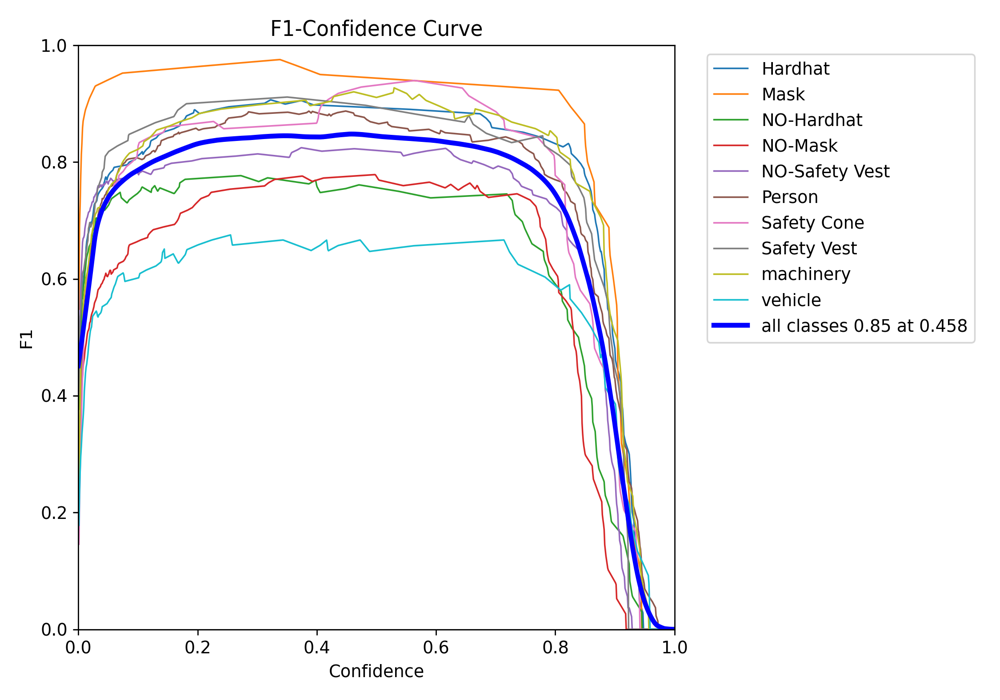

In [ ]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][2]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)


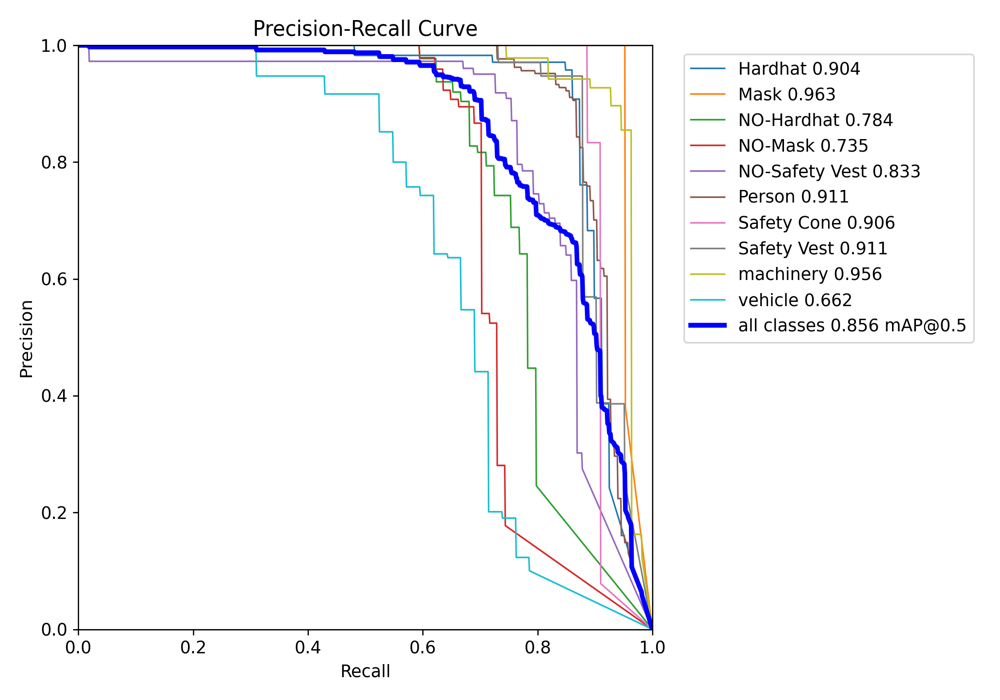

In [ ]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][3]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)


# Plotting the Precision against Confidence

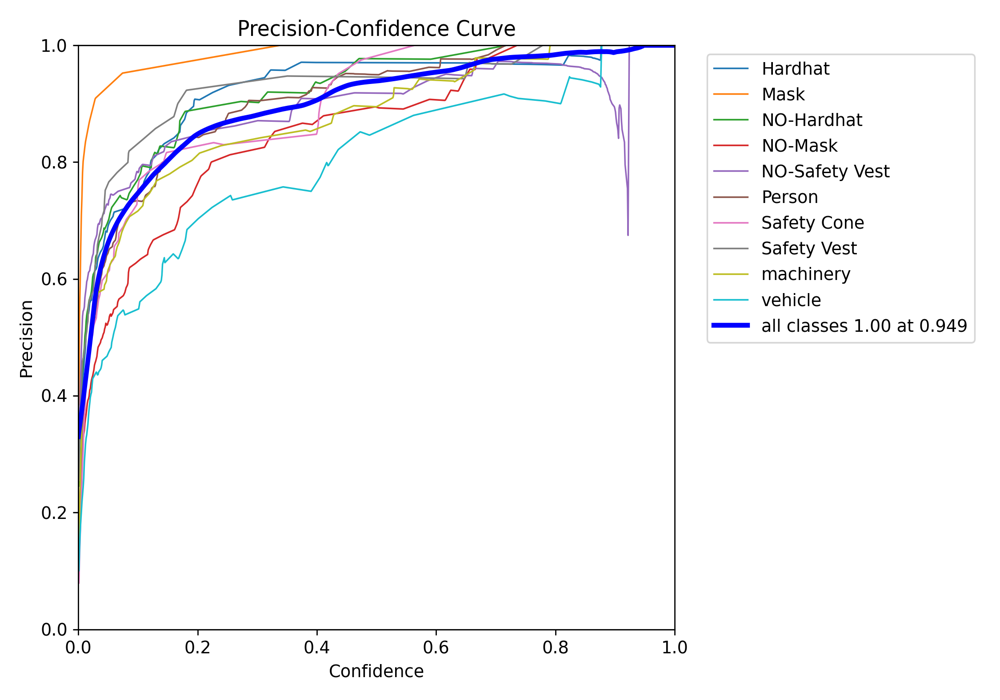

In [ ]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][4]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)


# Plotting the Losses

## Plotting the metrics/mAP50(B)


In [ ]:
def load_map_scores(results_file):

  map_scores = []
  with open(results_file, 'r') as f:
    reader = csv.reader(f)
    for row in reader:
      try:
        map_scores.append(float(row[6]))
      except ValueError:
        pass
  return map_scores

def plot_map_scores(map_scores, epochs, save_path):

  fig, ax = plt.subplots()
  ax.plot(epochs, map_scores)
  ax.set_xlabel('Epoch')
  ax.set_ylabel('mAP')
  ax.set_title('metrics/mAP50(B)')
  ax.grid(True)
  fig.savefig(save_path)


results = r'.\training_results\Construction_Site_Safety3\results.csv'
map_scores = load_map_scores(results)

if not map_scores:
  print('Error loading the YOLOv8 training results file.')
  exit(1)

epochs = np.arange(len(map_scores)).astype(int)

save_path = r'.\training_results\Construction_Site_Safety3\map_scores.png'
plot_map_scores(map_scores, epochs, save_path)


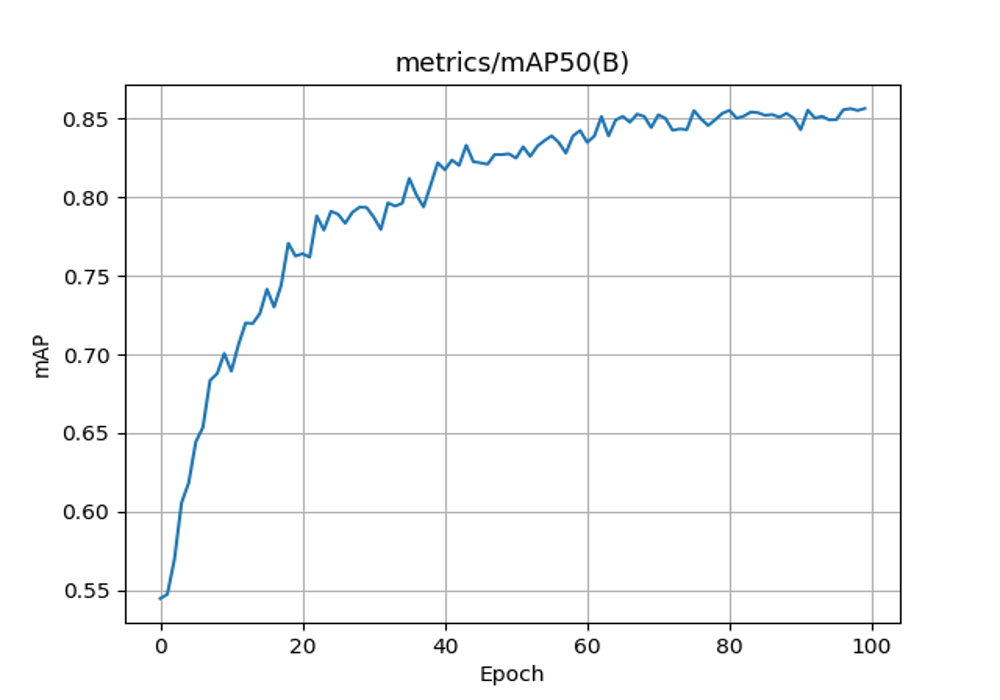

In [ ]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][3]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)

## Plotting the metrics/mAP50-95(B)



In [ ]:
def load_map_scores(results_file):

  map_scores = []
  with open(results_file, 'r') as f:
    reader = csv.reader(f)
    for row in reader:
      try:
        map_scores.append(float(row[7]))
      except ValueError:
        pass
  return map_scores

def plot_map_scores(map_scores, epochs, save_path):

  fig, ax = plt.subplots()
  ax.plot(epochs, map_scores)
  ax.set_xlabel('Epoch')
  ax.set_ylabel('mAP')
  ax.set_title('metrics/mAP50-95(B)')
  ax.grid(True)
  fig.savefig(save_path)


results = r'.\training_results\Construction_Site_Safety3\results.csv'
map_scores = load_map_scores(results)

if not map_scores:
  print('Error loading the YOLOv8 training results file.')
  exit(1)

epochs = np.arange(len(map_scores)).astype(int)

save_path = r'.\training_results\Construction_Site_Safety3\map_scores1.png'
plot_map_scores(map_scores, epochs, save_path)


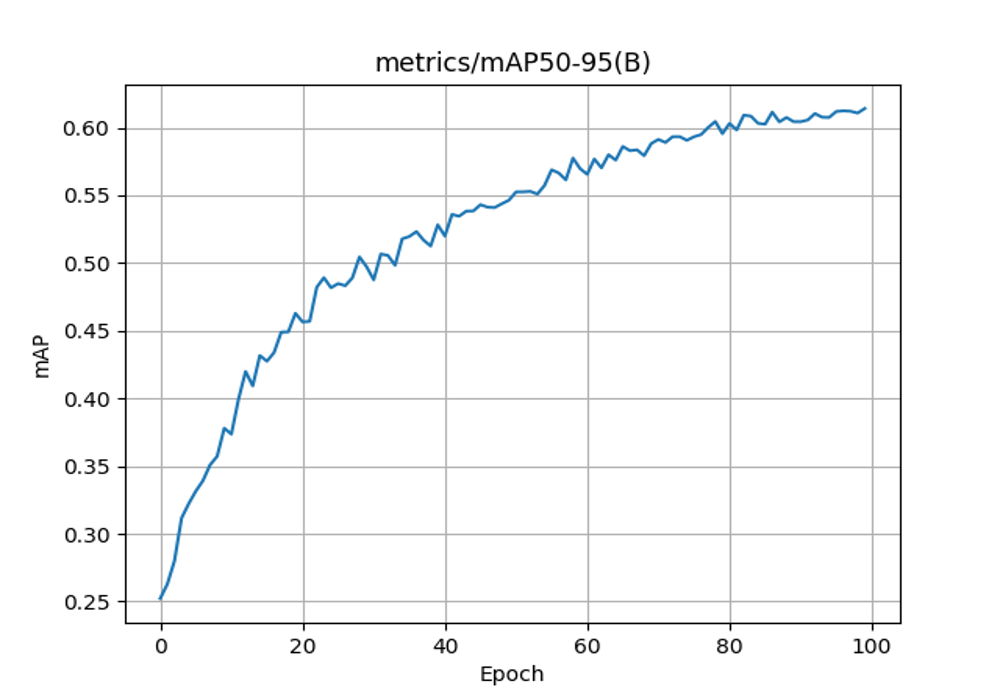

In [ ]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][4]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)


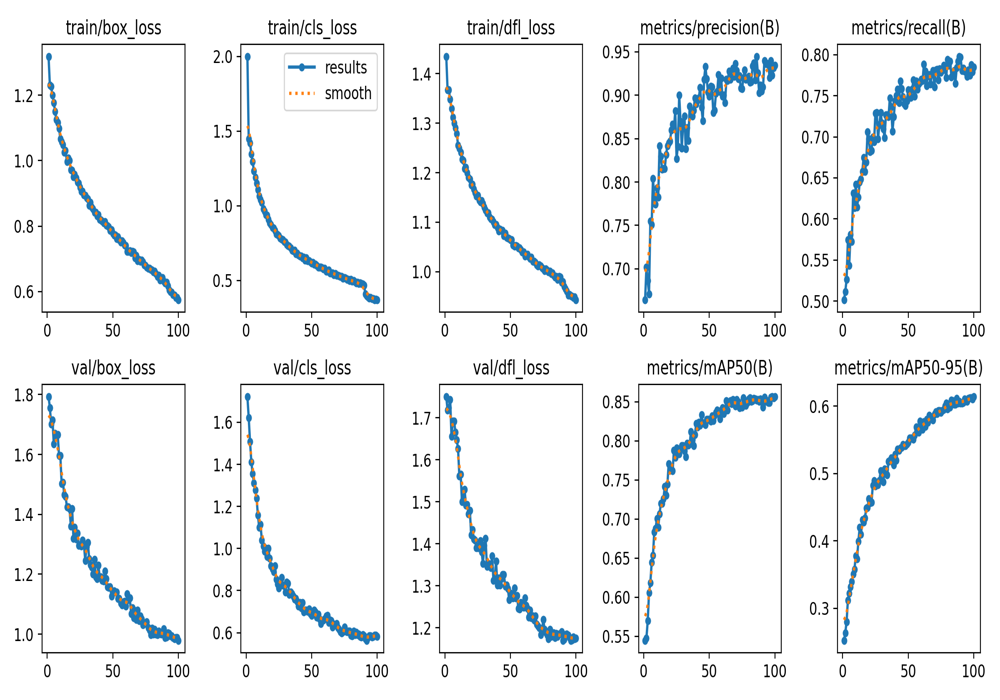

In [ ]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][7]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)


# Generating the Recall Confidence Curve

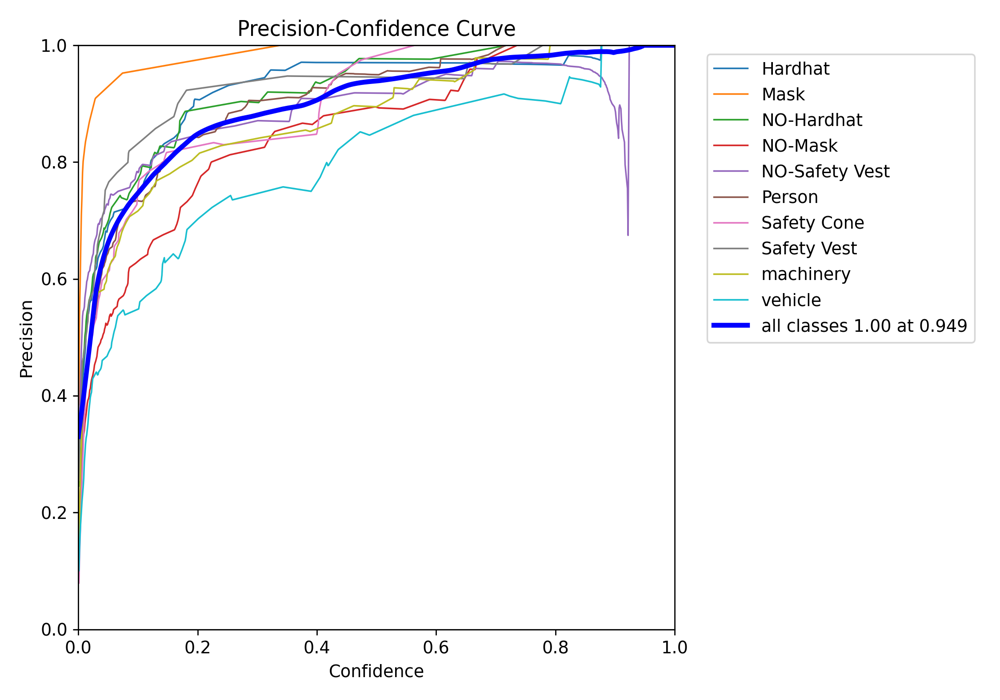

In [ ]:
png_image = [f for f in os.listdir(directory_path) if f.endswith(".png")][6]
rgb_image = Image.open(os.path.join(directory_path, png_image)).convert("RGB").resize((1000, 700))
display(rgb_image)


# Visualization of Labeled Validation Images

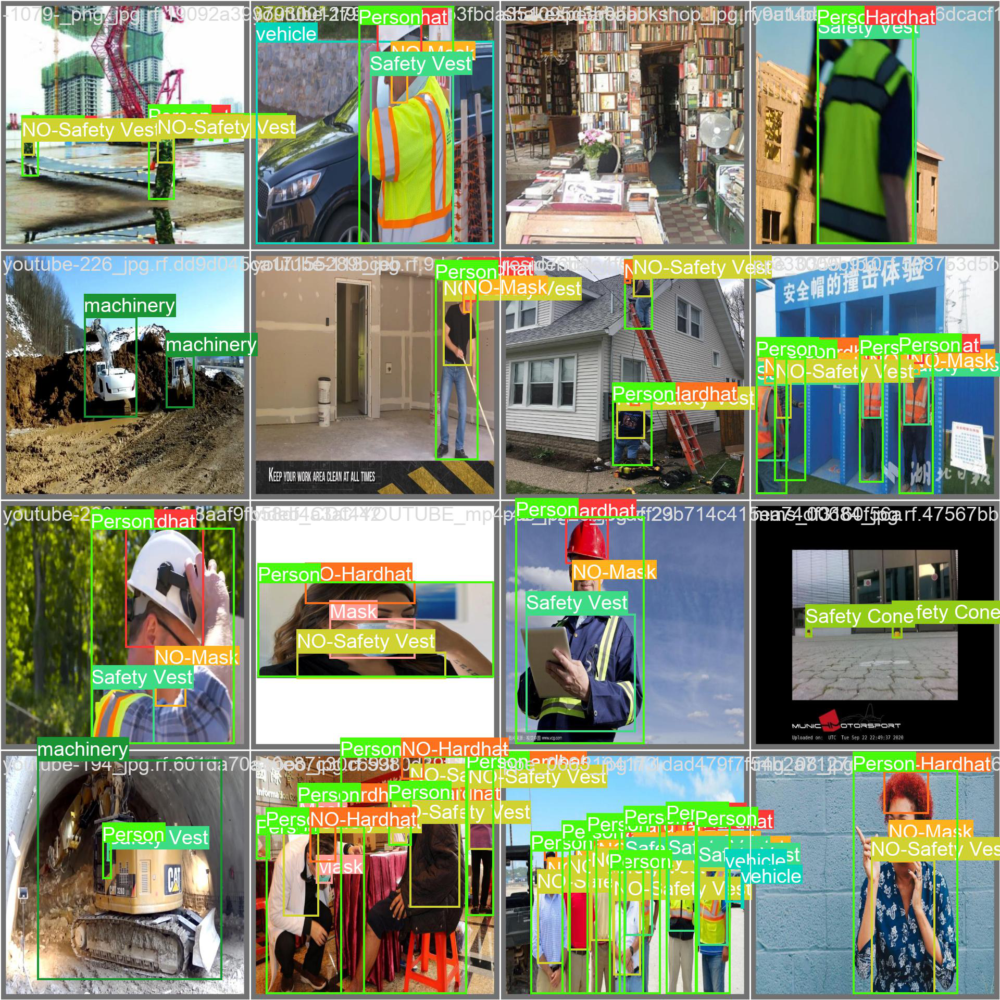

In [ ]:
images = [f for f in os.listdir(directory_path) if f.endswith(".jpg") or f.endswith(".jpeg")]

image1 = images[8]
display(Image.open(os.path.join(directory_path, image1)))


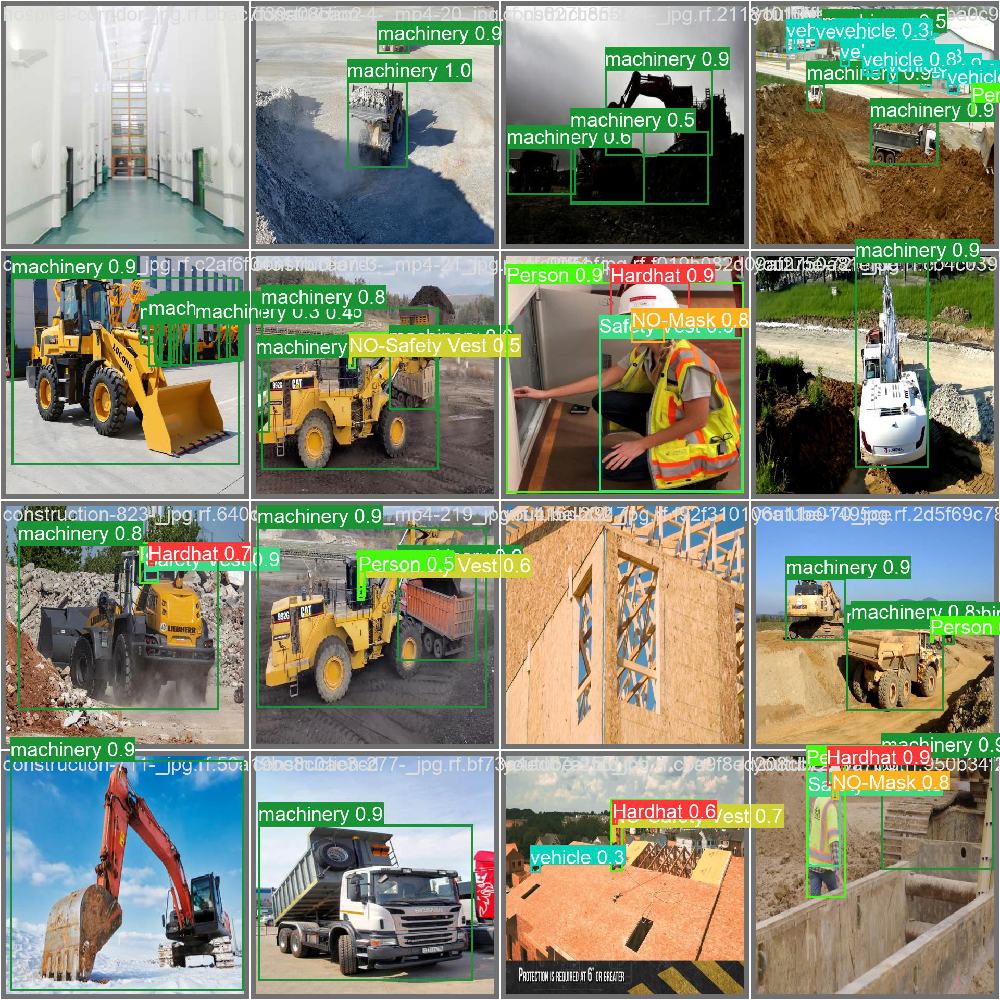

In [ ]:
images = [f for f in os.listdir(directory_path) if f.endswith(".jpg") or f.endswith(".jpeg")]

image1 = images[11]
display(Image.open(os.path.join(directory_path, image1)))


# Model Inference on Testing Images

In [ ]:
# load the custom model
model = YOLO(r".\training_results\Construction_Site_Safety3\weights\best.pt")

# Use the model to detect object
model.predict(source=testing_images_path, save=True)



image 1/18 C:\Users\lawrenceJICA\Desktop\model_1\test_images\-1989-_png_jpg.rf.8cb3d6087bb86d08e693b4250fbf96e3.jpg: 640x640 5 Hardhats, 4 NO-Masks, 5 NO-Safety Vests, 5 Persons, 38.8ms
image 2/18 C:\Users\lawrenceJICA\Desktop\model_1\test_images\-211-_png_jpg.rf.eac228e3993f9027795b6400262811e7.jpg: 640x640 1 Hardhat, 2 NO-Masks, 4 Persons, 4 Safety Vests, 41.9ms
image 3/18 C:\Users\lawrenceJICA\Desktop\model_1\test_images\1125_jpg.rf.2958d0a57630bdde8c3b5c6c560152af.jpg: 640x640 2 NO-Hardhats, 4 NO-Safety Vests, 4 Persons, 1 Safety Cone, 42.5ms
image 4/18 C:\Users\lawrenceJICA\Desktop\model_1\test_images\2009_000461_jpg.rf.43a28e2d6f1f9d399c92e18ccc9f0bf1.jpg: 640x640 1 Hardhat, 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 26.7ms
image 5/18 C:\Users\lawrenceJICA\Desktop\model_1\test_images\2009_004100_jpg.rf.6eb0dc058fc0d307a6b0f7f579945e24.jpg: 640x640 1 NO-Hardhat, 1 NO-Mask, 2 NO-Safety Vests, 1 Person, 26.0ms
image 6/18 C:\Users\lawrenceJICA\Desktop\model_1\test_images\IMG_3100_mp4-3_

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Hardhat', 1: 'Mask', 2: 'NO-Hardhat', 3: 'NO-Mask', 4: 'NO-Safety Vest', 5: 'Person', 6: 'Safety Cone', 7: 'Safety Vest', 8: 'machinery', 9: 'vehicle'}
 orig_img: array([[[190, 192, 193],
         [192, 194, 195],
         [194, 196, 197],
         ...,
         [ 33,  30,  25],
         [ 26,  26,  20],
         [ 22,  23,  14]],
 
        [[193, 195, 196],
         [194, 196, 197],
         [196, 198, 199],
         ...,
         [ 31,  31,  25],
         [ 26,  26,  20],
         [ 22,  23,  14]],
 
        [[195, 197, 198],
         [196, 198, 199],
         [198, 200, 201],
         ...,
         [ 30,  30,  24],
         [ 26,  26,  20],
         [ 20,  23,  14]],
 
        ...,
 
        [[ 36,  31,  28],
         [ 37,  32,  29],
         [ 38,  33,  30],
         ...,
         [ 70,  81,  89],
         [ 65,  76,  84],
       


# Visualization of predicted Testing Images

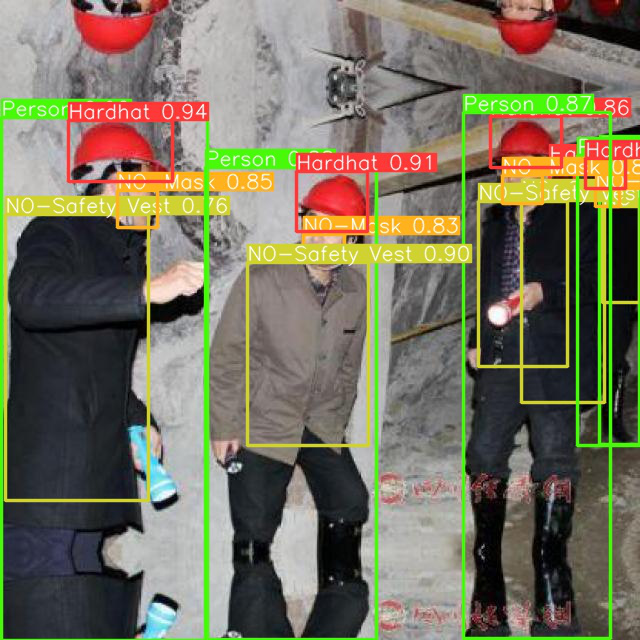

In [ ]:
# Get the directory path
dpath = r"C:\Users\lawrenceJICA\Desktop\model_1\runs\detect\predict"

images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[0])))


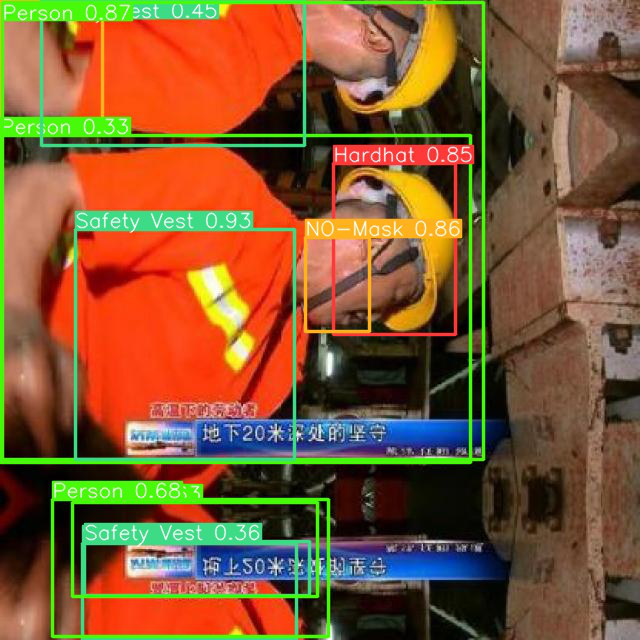

In [ ]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[1])))

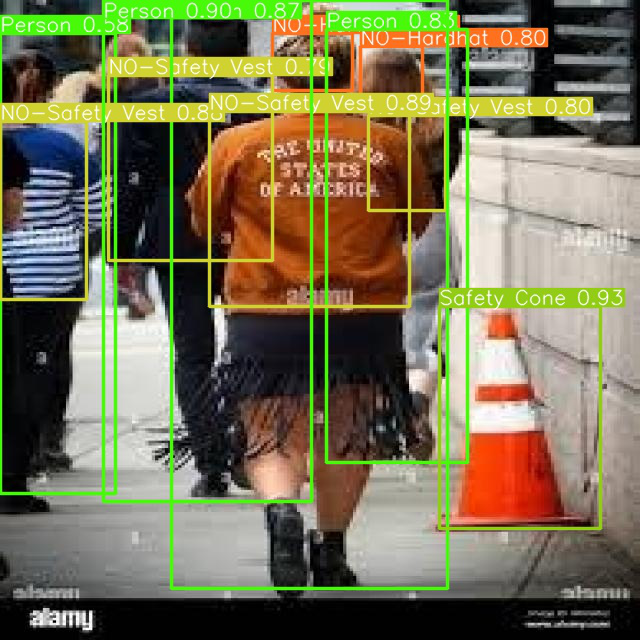

In [ ]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[2])))

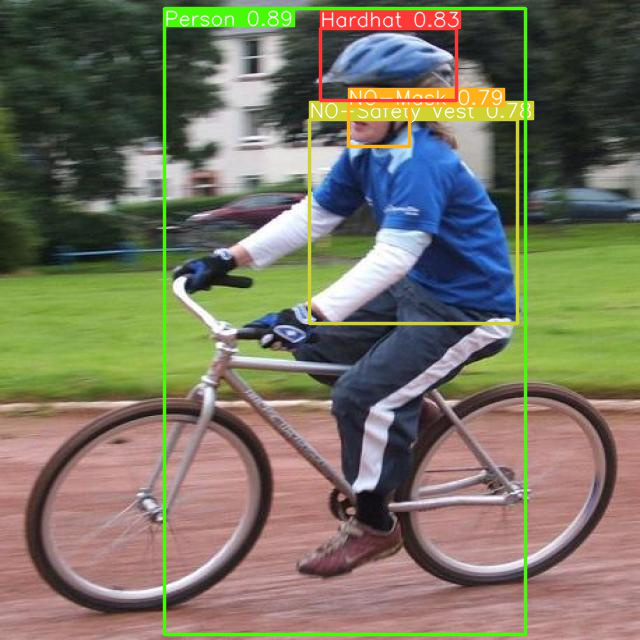

In [ ]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[3])))

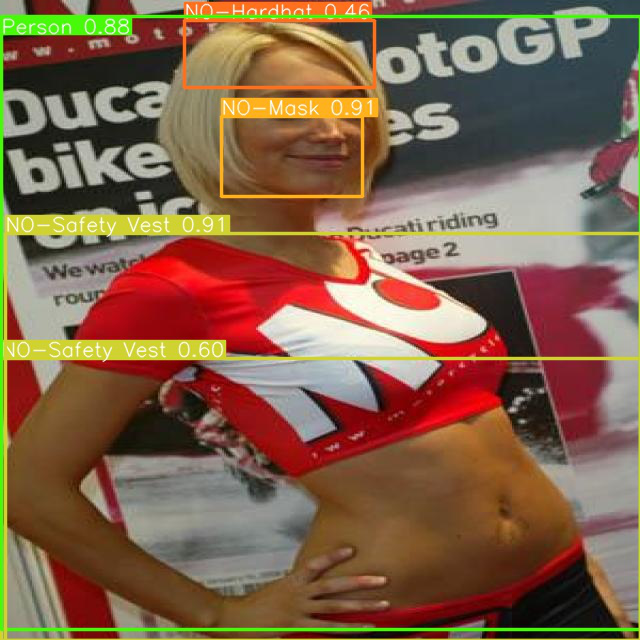

In [ ]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[4])))

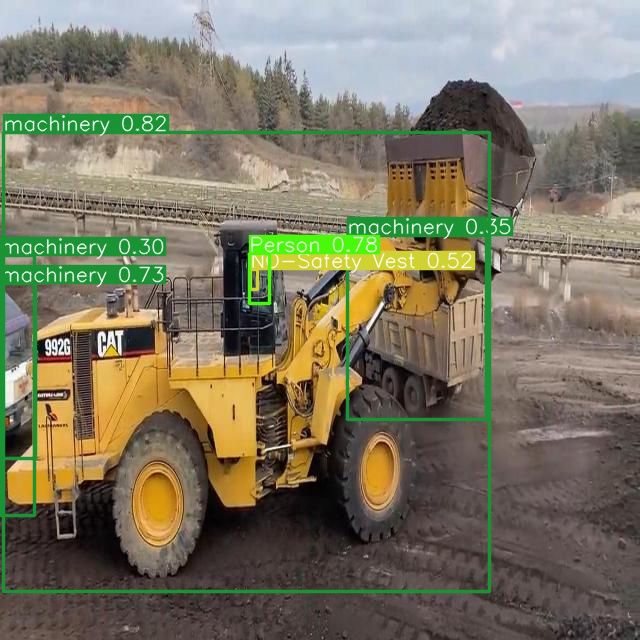

In [ ]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[5])))

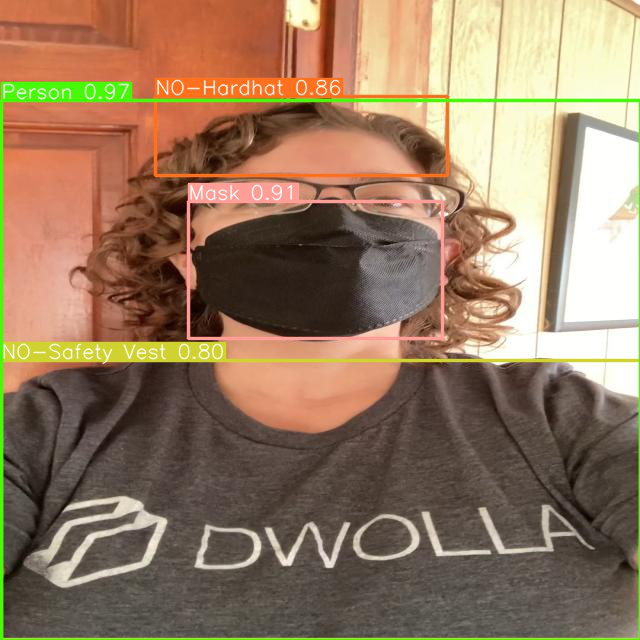

In [ ]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[8])))

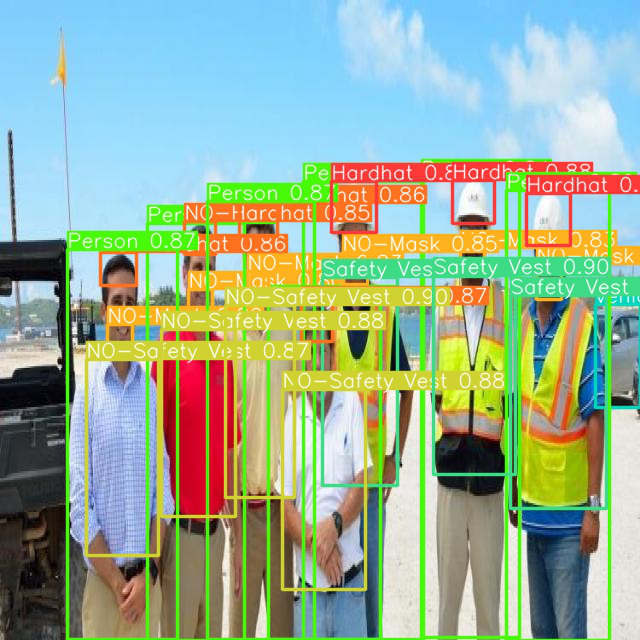

In [ ]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[10])))

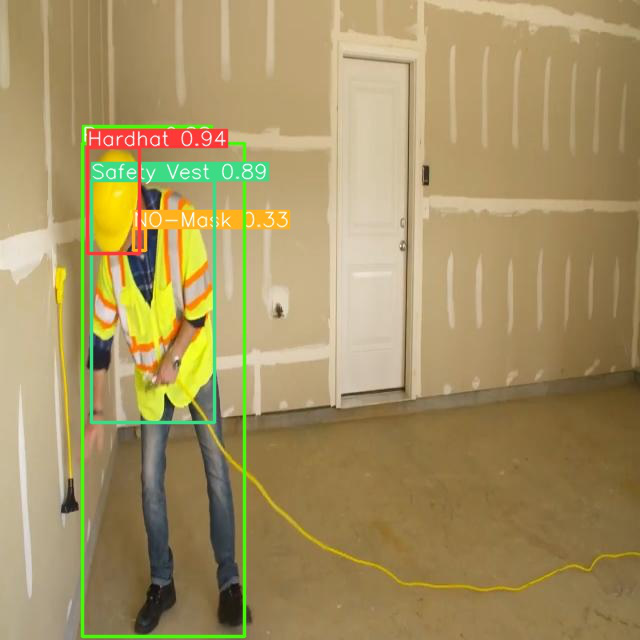

In [ ]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[15])))

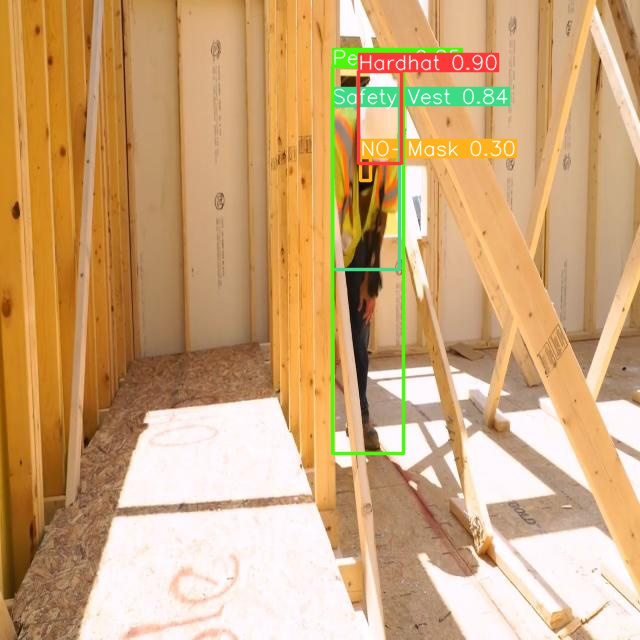

In [ ]:
images = [f for f in os.listdir(dpath) if f.endswith(".jpg") or f.endswith(".jpeg")]
display(Image.open(os.path.join(dpath, images[14])))

# Inferencing on video


In [ ]:
# For video
from ultralytics import YOLO

# Load custom trained YOLOv8 model
model = YOLO(r".\training_results\Construction_Site_Safety3\weights\best.pt")

# Use the model to detect object
model.predict(source=testing_videos_path, save=True)



WARNING  inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/2 (1/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 1 vehicle, 77.4ms
video 1/2 (2/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 1 vehicle, 12.0ms
video 1/2 (3/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 1 vehicle, 

video 1/2 (50/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 1 machinery, 5.0ms
video 1/2 (51/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 1 machinery, 12.7ms
video 1/2 (52/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 NO-Safety Vest, 2 Persons, 1 machinery, 11.0ms
video 1/2 (53/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 1 machinery, 1 vehicle, 5.1ms
video 1/2 (54/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 NO-Safety Vests, 3 Persons, 1 machinery, 11.0ms
video 1/2 (55/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 NO-Safety Vest, 2 Persons, 1 machinery, 6.7ms
video 1

video 1/2 (101/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 1 machinery, 3.0ms
video 1/2 (102/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 1 machinery, 14.5ms
video 1/2 (103/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 14.1ms
video 1/2 (104/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 1 machinery, 15.7ms
video 1/2 (105/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 1 machinery, 11.2ms
video 1/2 (106/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 1 machinery, 14.7ms
video 1/2 (107/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction

video 1/2 (154/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 13.9ms
video 1/2 (155/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 13.7ms
video 1/2 (156/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 13.2ms
video 1/2 (157/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 14.7ms
video 1/2 (158/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 11.2ms
video 1/2 (159/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 12.9ms
video 1/2 (160/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 3

video 1/2 (210/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 10.3ms
video 1/2 (211/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 15.6ms
video 1/2 (212/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 13.0ms
video 1/2 (213/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 11.3ms
video 1/2 (214/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 14.3ms
video 1/2 (215/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 15.7ms
video 1/2 (216/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career 

video 1/2 (266/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 11.7ms
video 1/2 (267/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 16.0ms
video 1/2 (268/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 8.2ms
video 1/2 (269/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 11.1ms
video 1/2 (270/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 0.0ms
video 1/2 (271/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 8.1ms
video 1/2 (272/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 ma

video 1/2 (315/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 16.2ms
video 1/2 (316/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 16.4ms
video 1/2 (317/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 10.7ms
video 1/2 (318/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 NO-Safety Vest, 2 Persons, 1 Safety Vest, 18.3ms
video 1/2 (319/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 8.1ms
video 1/2 (320/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction

video 1/2 (360/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 16.9ms
video 1/2 (361/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 15.9ms
video 1/2 (362/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 13.6ms
video 1/2 (363/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 16.3ms
video 1/2 (364/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 11.1ms
video 1/2 (365/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Car

video 1/2 (406/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 8.1ms
video 1/2 (407/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 16.2ms
video 1/2 (408/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 18.4ms
video 1/2 (409/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 16.2ms
video 1/2 (410/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 15.1ms
video 1/2 (411/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career 

video 1/2 (452/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 8.0ms
video 1/2 (453/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 9.5ms
video 1/2 (454/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 16.6ms
video 1/2 (455/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 3 NO-Masks, 1 Person, 1 Safety Vest, 16.1ms
video 1/2 (456/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 2 NO-Masks, 1 Person, 1 Safety Vest, 16.1ms
video 1/2 (457/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career

video 1/2 (498/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 12.1ms
video 1/2 (499/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 25.5ms
video 1/2 (500/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 19.4ms
video 1/2 (501/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 17.6ms
video 1/2 (502/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 22.8ms
video 1/2 (503/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career

video 1/2 (544/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 16.7ms
video 1/2 (545/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 7.3ms
video 1/2 (546/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 16.1ms
video 1/2 (547/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 14.7ms
video 1/2 (548/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 16.0ms
video 1/2 (549/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career 

video 1/2 (594/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 9.4ms
video 1/2 (595/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 16.9ms
video 1/2 (596/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 17.9ms
video 1/2 (597/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 16.5ms
video 1/2 (598/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 16.2ms
video 1/2 (599/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 9.0ms
video 1/2 (600/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Vi

video 1/2 (650/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 16.0ms
video 1/2 (651/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 18.7ms
video 1/2 (652/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 16.3ms
video 1/2 (653/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 15.9ms
video 1/2 (654/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 17.6ms
video 1/2 (655/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 15.6ms
video 1/2 (656/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career 

video 1/2 (706/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 8.1ms
video 1/2 (707/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 8.1ms
video 1/2 (708/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 22.1ms
video 1/2 (709/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 8.1ms
video 1/2 (710/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 15.6ms
video 1/2 (711/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 16.2ms
video 1/2 (712/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Vid

video 1/2 (762/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 15.6ms
video 1/2 (763/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 20.4ms
video 1/2 (764/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 12.6ms
video 1/2 (765/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 16.1ms
video 1/2 (766/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 16.1ms
video 1/2 (767/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 18.6ms
video 1/2 (768/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career 

video 1/2 (819/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 12.4ms
video 1/2 (820/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 16.4ms
video 1/2 (821/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 8.1ms
video 1/2 (822/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 8.2ms
video 1/2 (823/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 6.0ms
video 1/2 (824/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 10.0ms
video 1/2 (825/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machin

video 1/2 (875/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 8.1ms
video 1/2 (876/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 15.0ms
video 1/2 (877/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 0.0ms
video 1/2 (878/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 21.8ms
video 1/2 (879/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 8.5ms
video 1/2 (880/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 0.0ms
video 1/2 (881/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machine

video 1/2 (930/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 13.2ms
video 1/2 (931/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 8.0ms
video 1/2 (932/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 8.4ms
video 1/2 (933/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 8.1ms
video 1/2 (934/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 8.0ms
video 1/2 (935/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 8.1ms
video 1/2 (936/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 mach

video 1/2 (984/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 Person, 1 machinery, 17.5ms
video 1/2 (985/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 Person, 1 machinery, 9.6ms
video 1/2 (986/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 NO-Hardhat, 1 NO-Safety Vest, 1 Person, 1 machinery, 14.2ms
video 1/2 (987/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 NO-Hardhat, 1 Person, 1 machinery, 11.3ms
video 1/2 (988/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 NO-Hardhat, 1 machinery, 15.6ms
video 1/2 (989/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO

video 1/2 (1037/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 NO-Safety Vest, 2 Persons, 8.6ms
video 1/2 (1038/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 NO-Safety Vest, 2 Persons, 10.2ms
video 1/2 (1039/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 8.0ms
video 1/2 (1040/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 15.4ms
video 1/2 (1041/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 16.4ms
video 1/2 (1042/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 15.7ms
video 1/2 (1043/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Care

video 1/2 (1093/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 8.0ms
video 1/2 (1094/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 11.7ms
video 1/2 (1095/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 9.7ms
video 1/2 (1096/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 1 vehicle, 6.1ms
video 1/2 (1097/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 8.8ms
video 1/2 (1098/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 11.5ms
video 1/2 (1099/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Pers

video 1/2 (1146/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 8.2ms
video 1/2 (1147/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 8.0ms
video 1/2 (1148/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 2 NO-Masks, 1 NO-Safety Vest, 1 Person, 15.6ms
video 1/2 (1149/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 2 NO-Masks, 1 Person, 16.9ms
video 1/2 (1150/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 13.9ms
video 1/2 (1151/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 

video 1/2 (1196/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 16.3ms
video 1/2 (1197/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 8.1ms
video 1/2 (1198/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 2 NO-Masks, 1 Person, 8.0ms
video 1/2 (1199/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 2 NO-Masks, 1 Person, 17.1ms
video 1/2 (1200/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 8.8ms
video 1/2 (1201/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 8.2m

video 1/2 (1247/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 Person, 11.0ms
video 1/2 (1248/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 Person, 11.0ms
video 1/2 (1249/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 Person, 11.0ms
video 1/2 (1250/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 11.0ms
video 1/2 (1251/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 11.0ms
video 1/2 (1252/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 11.0ms
video 1/2 (1253/3023) C:\Users\lawrenceJICA

video 1/2 (1298/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 15.7ms
video 1/2 (1299/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 vehicle, 16.2ms
video 1/2 (1300/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 vehicle, 13.0ms
video 1/2 (1301/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 11.9ms
video 1/2 (1302/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 12.0ms
video 1/2 (1303/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 12.0ms
video 1/2 (1304/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video

video 1/2 (1354/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 12.0ms
video 1/2 (1355/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 11.9ms
video 1/2 (1356/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 12.0ms
video 1/2 (1357/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 11.0ms
video 1/2 (1358/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 11.0ms
video 1/2 (1359/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 11.0ms
video 1/2 (1360/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators 

video 1/2 (1410/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 11.2ms
video 1/2 (1411/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 11.6ms
video 1/2 (1412/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 11.6ms
video 1/2 (1413/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 9.8ms
video 1/2 (1414/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 12.7ms
video 1/2 (1415/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 4.0ms
video 1/2 (1416/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 

video 1/2 (1467/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 14.0ms
video 1/2 (1468/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 10.0ms
video 1/2 (1469/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 12.6ms
video 1/2 (1470/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 12.0ms
video 1/2 (1471/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 13.8ms
video 1/2 (1472/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 12.7ms
video 1/2 (1473/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x64

video 1/2 (1524/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 12.2ms
video 1/2 (1525/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 11.6ms
video 1/2 (1526/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 18.3ms
video 1/2 (1527/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 19.3ms
video 1/2 (1528/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 18.2ms
video 1/2 (1529/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 12.0ms
video 1/2 (1530/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x64

video 1/2 (1580/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 1 machinery, 18.6ms
video 1/2 (1581/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 1 machinery, 10.9ms
video 1/2 (1582/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 1 machinery, 11.1ms
video 1/2 (1583/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 10.0ms
video 1/2 (1584/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 11.7ms
video 1/2 (1585/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 9.9ms
video 1/2 (1586/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Opera

video 1/2 (1637/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 9.2ms
video 1/2 (1638/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 7.2ms
video 1/2 (1639/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 11.0ms
video 1/2 (1640/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 13.1ms
video 1/2 (1641/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 11.0ms
video 1/2 (1642/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 16.6ms
video 1/2 (1643/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 

video 1/2 (1693/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 3 machinerys, 8.5ms
video 1/2 (1694/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 10.6ms
video 1/2 (1695/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 9.8ms
video 1/2 (1696/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 3 machinerys, 11.7ms
video 1/2 (1697/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 3 machinerys, 11.3ms
video 1/2 (1698/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 11.6ms
video 1/2 (1699/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 38

video 1/2 (1749/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 3 machinerys, 10.3ms
video 1/2 (1750/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 10.0ms
video 1/2 (1751/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 16.5ms
video 1/2 (1752/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 11.2ms
video 1/2 (1753/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 3 machinerys, 14.0ms
video 1/2 (1754/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 11.0ms
video 1/2 (1755/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 

video 1/2 (1804/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 2 machinerys, 10.8ms
video 1/2 (1805/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 2 machinerys, 7.5ms
video 1/2 (1806/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 2 machinerys, 12.2ms
video 1/2 (1807/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 2 machinerys, 11.2ms
video 1/2 (1808/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 2 machinerys, 12.0ms
video 1/2 (1809/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 10.1ms
video 1/2 (1810/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Con

video 1/2 (1860/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 11.1ms
video 1/2 (1861/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 12.8ms
video 1/2 (1862/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 13.2ms
video 1/2 (1863/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 12.0ms
video 1/2 (1864/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 11.0ms
video 1/2 (1865/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 12.7ms
video 1/2 (1866/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x64

video 1/2 (1917/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 11.0ms
video 1/2 (1918/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 11.5ms
video 1/2 (1919/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 12.8ms
video 1/2 (1920/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 11.0ms
video 1/2 (1921/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 8.8ms
video 1/2 (1922/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 3 machinerys, 12.6ms
video 1/2 (1923/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x6

video 1/2 (1974/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 11.6ms
video 1/2 (1975/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 11.6ms
video 1/2 (1976/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 9.3ms
video 1/2 (1977/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 12.6ms
video 1/2 (1978/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 11.8ms
video 1/2 (1979/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 13.1ms
video 1/2 (1980/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640

video 1/2 (2026/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 5 Persons, 2 Safety Vests, 12.8ms
video 1/2 (2027/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 4 Persons, 1 Safety Vest, 7.7ms
video 1/2 (2028/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 4 Persons, 1 Safety Vest, 9.4ms
video 1/2 (2029/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 NO-Safety Vest, 4 Persons, 12.0ms
video 1/2 (2030/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 NO-Safety Vest, 5 Persons, 1 Safety Vest, 18.0ms
video 1/2 (2031/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 NO-Safety Vests, 5 Persons, 1 Safety Vest, 10.1ms
video 1

video 1/2 (2073/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 NO-Safety Vest, 6 Persons, 1 Safety Vest, 12.3ms
video 1/2 (2074/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 NO-Safety Vest, 4 Persons, 1 Safety Vest, 12.8ms
video 1/2 (2075/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 NO-Safety Vest, 4 Persons, 1 Safety Vest, 11.9ms
video 1/2 (2076/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 4 Persons, 1 Safety Vest, 6.4ms
video 1/2 (2077/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 12.6ms
video 1/2 (2078/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 12.6ms
video 1/2 (2079/3

video 1/2 (2129/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 10.6ms
video 1/2 (2130/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 13.6ms
video 1/2 (2131/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 10.6ms
video 1/2 (2132/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 13.7ms
video 1/2 (2133/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 13.7ms
video 1/2 (2134/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 13.6ms
video 1/2 (2135/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 

video 1/2 (2185/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 3 machinerys, 12.4ms
video 1/2 (2186/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 14.2ms
video 1/2 (2187/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 18.2ms
video 1/2 (2188/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 16.2ms
video 1/2 (2189/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 11.2ms
video 1/2 (2190/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 12.4ms
video 1/2 (2191/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 

video 1/2 (2241/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 19.6ms
video 1/2 (2242/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 18.6ms
video 1/2 (2243/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 10.4ms
video 1/2 (2244/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 10.0ms
video 1/2 (2245/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 16.9ms
video 1/2 (2246/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 14.3ms
video 1/2 (2247/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators 

video 1/2 (2296/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 12.9ms
video 1/2 (2297/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 18.4ms
video 1/2 (2298/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 10.1ms
video 1/2 (2299/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 20.4ms
video 1/2 (2300/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 18.2ms
video 1/2 (2301/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 13.9ms
video 1/2 (2302/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators 

video 1/2 (2351/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 11.4ms
video 1/2 (2352/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 14.7ms
video 1/2 (2353/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 10.1ms
video 1/2 (2354/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 10.4ms
video 1/2 (2355/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 10.7ms
video 1/2 (2356/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 10.2ms
video 1/2 (2357/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators 

video 1/2 (2405/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 1 machinery, 16.1ms
video 1/2 (2406/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 1 machinery, 13.2ms
video 1/2 (2407/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 1 machinery, 14.8ms
video 1/2 (2408/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 1 machinery, 13.9ms
video 1/2 (2409/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 1 machinery, 10.1ms
video 1/2 (2410/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 1 machinery, 21.6ms
video 1/2 (2411/3023) C:\Users\lawrenceJICA\Desktop\model_1\vide

video 1/2 (2458/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 1 machinery, 21.0ms
video 1/2 (2459/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 1 machinery, 16.4ms
video 1/2 (2460/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 1 machinery, 12.7ms
video 1/2 (2461/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 4 Persons, 1 machinery, 13.5ms
video 1/2 (2462/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 1 machinery, 11.4ms
video 1/2 (2463/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 1 machinery, 9.0ms
video 1/2 (2464/3023) C:\Users\lawrenceJICA\Desktop\model_1

video 1/2 (2513/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 1 machinery, 16.5ms
video 1/2 (2514/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 1 machinery, 13.9ms
video 1/2 (2515/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 1 machinery, 13.0ms
video 1/2 (2516/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 11.9ms
video 1/2 (2517/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 14.2ms
video 1/2 (2518/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 9.7ms
video 1/2 (2519/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators

video 1/2 (2570/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 16.6ms
video 1/2 (2571/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 3 Persons, 8.2ms
video 1/2 (2572/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 19.5ms
video 1/2 (2573/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 11.2ms
video 1/2 (2574/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 3 Persons, 16.4ms
video 1/2 (2575/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 3 Persons, 16.4ms
video 1/2 (2576/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 Persons, 1

video 1/2 (2626/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 8.2ms
video 1/2 (2627/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 8.9ms
video 1/2 (2628/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 8.2ms
video 1/2 (2629/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 19.1ms
video 1/2 (2630/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 0.0ms
video 1/2 (2631/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 13.4ms
video 1/2 (2632/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Care

video 1/2 (2681/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 13.2ms
video 1/2 (2682/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 16.2ms
video 1/2 (2683/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 15.4ms
video 1/2 (2684/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 11.3ms
video 1/2 (2685/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 17.7ms
video 1/2 (2686/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 10.9ms
video 1/2 (2687/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators 

video 1/2 (2736/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 13.7ms
video 1/2 (2737/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 13.5ms
video 1/2 (2738/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 14.4ms
video 1/2 (2739/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 13.8ms
video 1/2 (2740/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 12.9ms
video 1/2 (2741/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 13.7ms
video 1/2 (2742/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x64

video 1/2 (2793/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 2 machinerys, 13.6ms
video 1/2 (2794/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 9.9ms
video 1/2 (2795/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 14.7ms
video 1/2 (2796/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 13.4ms
video 1/2 (2797/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 10.3ms
video 1/2 (2798/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 machinery, 13.7ms
video 1/2 (2799/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x64

video 1/2 (2849/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 10.1ms
video 1/2 (2850/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 13.1ms
video 1/2 (2851/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 10.0ms
video 1/2 (2852/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 14.7ms
video 1/2 (2853/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 15.6ms
video 1/2 (2854/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 1 Person, 12.0ms
video 1/2 (2855/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384

video 1/2 (2905/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 20.5ms
video 1/2 (2906/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 10.2ms
video 1/2 (2907/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 21.0ms
video 1/2 (2908/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 13.0ms
video 1/2 (2909/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 18.2ms
video 1/2 (2910/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 13.8ms
video 1/2 (2911/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators 

video 1/2 (2960/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 14.7ms
video 1/2 (2961/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 12.0ms
video 1/2 (2962/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 14.5ms
video 1/2 (2963/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 13.9ms
video 1/2 (2964/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 12.3ms
video 1/2 (2965/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 10.2ms
video 1/2 (2966/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators 

video 1/2 (3015/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 14.6ms
video 1/2 (3016/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 12.8ms
video 1/2 (3017/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 13.0ms
video 1/2 (3018/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 14.9ms
video 1/2 (3019/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 8.6ms
video 1/2 (3020/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators Career Video.mp4: 384x640 (no detections), 13.7ms
video 1/2 (3021/3023) C:\Users\lawrenceJICA\Desktop\model_1\videos\Construction Equipment Operators C

video 2/2 (29/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 1 machinery, 2 vehicles, 14.2ms
video 2/2 (30/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 1 vehicle, 12.7ms
video 2/2 (31/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 1 vehicle, 14.1ms
video 2/2 (32/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 1 vehi

video 2/2 (64/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 12.7ms
video 2/2 (65/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 14.6ms
video 2/2 (66/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 14.7ms
video 2/2 (67/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 13.6ms
video 2/2 (68/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 10.7ms
video 2/2 (69/4196) C:\Users\

video 2/2 (102/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Hardhat, 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 7.3ms
video 2/2 (103/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Hardhat, 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 13.7ms
video 2/2 (104/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 7.8ms
video 2/2 (105/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 13.7ms
video 2/2 (106/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operat

video 2/2 (141/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 13.3ms
video 2/2 (142/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 13.7ms
video 2/2 (143/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 14.1ms
video 2/2 (144/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Hardhat, 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 1 Safety Vest, 13.8ms
video 2/2 (145/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Mo

video 2/2 (177/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 2 NO-Safety Vests, 3 Persons, 14.0ms
video 2/2 (178/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 2 NO-Safety Vests, 3 Persons, 13.3ms
video 2/2 (179/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 3 NO-Safety Vests, 3 Persons, 1 Safety Vest, 10.1ms
video 2/2 (180/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 3 NO-Safety Vests, 3 Persons, 1 Safety Vest, 11.5ms
video 2/2 (181/4196) C:\Users\lawrenceJICA\

video 2/2 (212/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 12.0ms
video 2/2 (213/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 13.9ms
video 2/2 (214/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 13.9ms
video 2/2 (215/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Mask, 1 NO-Safety Vest, 1 Person, 10.3ms
video 2/2 (216/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Mo

video 2/2 (246/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 11.7ms
video 2/2 (247/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 13.8ms
video 2/2 (248/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 11.3ms
video 2/2 (249/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 12.3ms
video 2/2 (250/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Safety Vest, 16.9ms
video 2/2

video 2/2 (288/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 13.2ms
video 2/2 (289/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 25.5ms
video 2/2 (290/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 10.1ms
video 2/2 (291/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 11.3ms
video 2/2 (292/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 11.0ms
video 2/2 

video 2/2 (330/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Vest, 10.5ms
video 2/2 (331/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Vest, 13.6ms
video 2/2 (332/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Vest, 11.2ms
video 2/2 (333/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 Safety Vest, 13.7ms
video 2/2 (334/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1

video 2/2 (368/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Vest, 1 machinery, 14.4ms
video 2/2 (369/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Vest, 1 machinery, 11.1ms
video 2/2 (370/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 2 Safety Vests, 11.8ms
video 2/2 (371/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 2 Safety Vests, 1 machinery, 12.5ms
video 2/2 (372/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and H

video 2/2 (405/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 2 Safety Vests, 14.6ms
video 2/2 (406/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 2 Safety Vests, 13.7ms
video 2/2 (407/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Hardhat, 1 Person, 1 Safety Vest, 13.6ms
video 2/2 (408/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 Person, 1 Safety Vest, 14.6ms
video 2/2 (409/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprentices

video 2/2 (441/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 13.0ms
video 2/2 (442/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 14.7ms
video 2/2 (443/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 12.3ms
video 2/2 (444/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety

video 2/2 (473/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 13.7ms
video 2/2 (474/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 13.0ms
video 2/2 (475/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 10.8ms
video 2/2 (476/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety

video 2/2 (505/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 11.6ms
video 2/2 (506/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 13.0ms
video 2/2 (507/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 10.4ms
video 2/2 (508/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Ve

video 2/2 (537/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 11.0ms
video 2/2 (538/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 14.1ms
video 2/2 (539/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 1 machinery, 13.3ms
video 2/2 (540/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety V

video 2/2 (570/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 14.3ms
video 2/2 (571/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 13.4ms
video 2/2 (572/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 13.2ms
video 2/2 (573/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 

video 2/2 (603/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 2 NO-Masks, 1 Person, 1 Safety Vest, 2 machinerys, 3.0ms
video 2/2 (604/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 13.2ms
video 2/2 (605/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 7.1ms
video 2/2 (606/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 2.2ms
video 2/2 (607/4196) C:\Users\lawren

video 2/2 (637/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 19.8ms
video 2/2 (638/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 14.9ms
video 2/2 (639/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 14.0ms
video 2/2 (640/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 10.5ms
video 2/2 (641/4196) C:\Users\lawren

video 2/2 (672/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Safety Vest, 1 machinery, 20.7ms
video 2/2 (673/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Safety Vest, 2 machinerys, 10.8ms
video 2/2 (674/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 15.3ms
video 2/2 (675/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 12.8ms
video 2/2 (676/4196) C:\Users\lawrenceJICA\Desktop\mode

video 2/2 (707/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 18.4ms
video 2/2 (708/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 17.5ms
video 2/2 (709/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 10.9ms
video 2/2 (710/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 18.9ms
video 2/2 (711/4196) C:\Users\la

video 2/2 (742/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 16.4ms
video 2/2 (743/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 11.7ms
video 2/2 (744/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 22.1ms
video 2/2 (745/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 machinery, 31.0ms
video 2/2 (746/4196) C:\Users\lawrenceJICA\Desktop

video 2/2 (776/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 24.5ms
video 2/2 (777/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 21.1ms
video 2/2 (778/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 16.8ms
video 2/2 (779/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 

video 2/2 (809/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 13.4ms
video 2/2 (810/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 16.0ms
video 2/2 (811/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 24.1ms
video 2/2 (812/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Ve

video 2/2 (842/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 15.6ms
video 2/2 (843/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 12.7ms
video 2/2 (844/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 11.3ms
video 2/2 (845/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 

video 2/2 (875/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 12.7ms
video 2/2 (876/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 10.5ms
video 2/2 (877/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 16.4ms
video 2/2 (878/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 

video 2/2 (908/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 8.5ms
video 2/2 (909/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 5.5ms
video 2/2 (910/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 11.9ms
video 2/2 (911/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 16.3ms
video 2/2 (912/4196) C:\Users\lawrence

video 2/2 (942/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 11.4ms
video 2/2 (943/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 14.6ms
video 2/2 (944/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 11.0ms
video 2/2 (945/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 11.4ms
video 2/2 (946/4196) C:\Users\law

video 2/2 (976/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 17.9ms
video 2/2 (977/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 11.7ms
video 2/2 (978/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 9.8ms
video 2/2 (979/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 14.4ms
video 2/2 (980/4196) C:\Users\lawr

video 2/2 (1010/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 13.4ms
video 2/2 (1011/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 14.0ms
video 2/2 (1012/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 20.0ms
video 2/2 (1013/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 11.4ms
video 2/2 (1014/4196) C:\Use

video 2/2 (1044/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 13.5ms
video 2/2 (1045/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 16.4ms
video 2/2 (1046/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 1 machinery, 22.1ms
video 2/2 (1047/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 16.4ms
video 2/2 (1048/4196) C:\Users\

video 2/2 (1078/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 18.7ms
video 2/2 (1079/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 4 machinerys, 14.1ms
video 2/2 (1080/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 18.3ms
video 2/2 (1081/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safe

video 2/2 (1111/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 13.6ms
video 2/2 (1112/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 12.2ms
video 2/2 (1113/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 9.6ms
video 2/2 (1114/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 12.3ms
v

video 2/2 (1145/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 18.6ms
video 2/2 (1146/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 6.1ms
video 2/2 (1147/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 23.0ms
video 2/2 (1148/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 14.4ms
video 2/2 (1149/4196) C:\User

video 2/2 (1179/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 18.5ms
video 2/2 (1180/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 28.5ms
video 2/2 (1181/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 18.4ms
video 2/2 (1182/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 12.6ms
video 2/2 (1183/4196) C:\Use

video 2/2 (1213/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 18.4ms
video 2/2 (1214/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 20.4ms
video 2/2 (1215/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 23.0ms
video 2/2 (1216/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 20.5ms
video 2/2 (1217/4196) C:\Users\l

video 2/2 (1247/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 17.3ms
video 2/2 (1248/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 28.3ms
video 2/2 (1249/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 2 Safety Vests, 2 machinerys, 16.4ms
video 2/2 (1250/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 2 Safet

video 2/2 (1281/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 25.0ms
video 2/2 (1282/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 12.8ms
video 2/2 (1283/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 16.5ms
video 2/2 (1284/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 18.5ms
video 2/2 (1285/4196) C:\Use

video 2/2 (1314/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 17.6ms
video 2/2 (1315/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 17.9ms
video 2/2 (1316/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 15.5ms
video 2/2 (1317/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 27.9ms
video 2/2 (1318/4196) C:\Users\

video 2/2 (1348/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 16.1ms
video 2/2 (1349/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 18.9ms
video 2/2 (1350/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 24.3ms
video 2/2 (1351/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 15.6ms
video 2/2 (1352/4196) C:\Use

video 2/2 (1382/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 16.6ms
video 2/2 (1383/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 16.1ms
video 2/2 (1384/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 22.5ms
video 2/2 (1385/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 16.1ms
video 2/2 (1386/4196) C:\User

video 2/2 (1415/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 24.4ms
video 2/2 (1416/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 11.7ms
video 2/2 (1417/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 16.1ms
video 2/2 (1418/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 24.8ms
video 2/2 (1419/4196) C:\Use

video 2/2 (1449/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 15.7ms
video 2/2 (1450/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 23.8ms
video 2/2 (1451/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 25.9ms
video 2/2 (1452/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 15.7ms
video 2/2 (1453/4196) C:\Use

video 2/2 (1483/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 22.6ms
video 2/2 (1484/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 26.2ms
video 2/2 (1485/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 24.1ms
video 2/2 (1486/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 16.1ms
video 2/2 (1487/4196) C:\Use

video 2/2 (1517/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 25.7ms
video 2/2 (1518/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 23.5ms
video 2/2 (1519/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 18.0ms
video 2/2 (1520/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 21.6ms
video 2/2 (1521/4196) C:\Use

video 2/2 (1551/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Safety Vest, 1 machinery, 1 vehicle, 16.5ms
video 2/2 (1552/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Safety Vest, 1 machinery, 1 vehicle, 16.2ms
video 2/2 (1553/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Safety Vest, 1 machinery, 1 vehicle, 16.2ms
video 2/2 (1554/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Safety Vest, 1 vehicle, 24.8ms
video 2/2 (1555/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dir

video 2/2 (1589/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Cone, 1 Safety Vest, 17.0ms
video 2/2 (1590/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Cone, 2 Safety Vests, 1 machinery, 1 vehicle, 14.3ms
video 2/2 (1591/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Cone, 2 Safety Vests, 1 vehicle, 26.7ms
video 2/2 (1592/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Cone, 2 Safety Vests, 1 vehicle, 26.4ms
video 2/2 (1593/4196) C:\Users\lawrenceJICA\Desktop\model_1\vid

video 2/2 (1626/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 2 Safety Cones, 1 Safety Vest, 1 machinery, 19.5ms
video 2/2 (1627/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Cone, 1 Safety Vest, 1 machinery, 21.5ms
video 2/2 (1628/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 2 Persons, 1 Safety Cone, 1 machinery, 21.8ms
video 2/2 (1629/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Cone, 1 machinery, 21.5ms
video 2/2 (1630/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer

video 2/2 (1664/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Cone, 1 machinery, 21.3ms
video 2/2 (1665/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Vest, 1 machinery, 14.1ms
video 2/2 (1666/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 22.5ms
video 2/2 (1667/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Vest, 21.8ms
video 2/2 (1668/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process

video 2/2 (1698/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 20.2ms
video 2/2 (1699/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 25.2ms
video 2/2 (1700/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 27.9ms
video 2/2 (1701/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 22.3ms


video 2/2 (1732/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 22.7ms
video 2/2 (1733/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 20.1ms
video 2/2 (1734/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 21.3ms
video 2/2 (1735/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 2 Safety Vests, 3 machinerys, 14.9ms
video 2/2 (1736/4196) C:\Us

video 2/2 (1765/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 19.1ms
video 2/2 (1766/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 22.6ms
video 2/2 (1767/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 22.3ms
video 2/2 (1768/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Hardhat, 1 NO-Mask, 1 Person, 1 Safe

video 2/2 (1798/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 22.6ms
video 2/2 (1799/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 19.1ms
video 2/2 (1800/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 19.4ms
video 2/2 (1801/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 18.3ms
video 2/2 (1802/4196) C:\Use

video 2/2 (1832/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 19.6ms
video 2/2 (1833/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 19.7ms
video 2/2 (1834/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 19.6ms
video 2/2 (1835/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 21.2ms
video 2/2 (1836/4196) C:

video 2/2 (1866/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 19.1ms
video 2/2 (1867/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 17.9ms
video 2/2 (1868/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 25.5ms
video 2/2 (1869/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 24.6ms
video 2/2 (1870/4196) C:\U

video 2/2 (1900/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 4 machinerys, 21.1ms
video 2/2 (1901/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 4 machinerys, 18.1ms
video 2/2 (1902/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 21.3ms
video 2/2 (1903/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 19.5ms
video 2/2 (1904/4196) C:\Use

video 2/2 (1934/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 18.8ms
video 2/2 (1935/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.4ms
video 2/2 (1936/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.3ms
video 2/2 (1937/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 16.2ms
video 2/2 (1938/4196) C:\U

video 2/2 (1968/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 22.4ms
video 2/2 (1969/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 21.3ms
video 2/2 (1970/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 21.7ms
video 2/2 (1971/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 21.2ms
video 2/2 (1972/4196) C:\Use

video 2/2 (2002/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 2 Hardhats, 2 NO-Masks, 2 Persons, 2 Safety Vests, 4 vehicles, 20.4ms
video 2/2 (2003/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 2 Hardhats, 2 NO-Masks, 1 NO-Safety Vest, 2 Persons, 2 Safety Vests, 3 vehicles, 21.7ms
video 2/2 (2004/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 2 Hardhats, 2 NO-Masks, 2 Persons, 2 Safety Vests, 3 vehicles, 22.2ms
video 2/2 (2005/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 2 Hardhats, 2 NO-Masks, 2 Persons, 2 Safety Vests, 2 vehicles, 22.0ms
vi

video 2/2 (2036/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 19.1ms
video 2/2 (2037/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 17.2ms
video 2/2 (2038/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 Person, 1 Safety Vest, 1 machinery, 20.7ms
video 2/2 (2039/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 Person, 1 Safety Vest, 1 machinery, 21.6ms
video 2/2 (2040/4196) C:\Users\lawrenceJICA\Desktop\mo

video 2/2 (2073/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Safety Vest, 1 machinery, 20.9ms
video 2/2 (2074/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Safety Vest, 1 machinery, 22.3ms
video 2/2 (2075/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Safety Vest, 1 machinery, 18.2ms
video 2/2 (2076/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Safety Vest, 1 machinery, 21.3ms
video 2/2 (2077/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Proces

video 2/2 (2109/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.7ms
video 2/2 (2110/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.6ms
video 2/2 (2111/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 21.1ms
video 2/2 (2112/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 4 machinerys, 22.3ms
video 2/2 (2113/4196) C:

video 2/2 (2143/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.3ms
video 2/2 (2144/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 19.5ms
video 2/2 (2145/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 17.7ms
video 2/2 (2146/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 4 machinerys, 21.7ms
video 2/2 (2147/4196) C:

video 2/2 (2177/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Cone, 1 Safety Vest, 3 machinerys, 15.9ms
video 2/2 (2178/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Cone, 1 Safety Vest, 3 machinerys, 22.3ms
video 2/2 (2179/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Cone, 1 Safety Vest, 3 machinerys, 21.1ms
video 2/2 (2180/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Cone, 

video 2/2 (2209/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Cone, 1 Safety Vest, 4 machinerys, 1 vehicle, 22.8ms
video 2/2 (2210/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Cone, 1 Safety Vest, 3 machinerys, 1 vehicle, 22.4ms
video 2/2 (2211/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Cone, 1 Safety Vest, 3 machinerys, 1 vehicle, 22.3ms
video 2/2 (2212/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO

video 2/2 (2241/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 1 vehicle, 21.6ms
video 2/2 (2242/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 1 vehicle, 21.0ms
video 2/2 (2243/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 1 vehicle, 18.2ms
video 2/2 (2244/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys

video 2/2 (2274/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 1 vehicle, 21.1ms
video 2/2 (2275/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 1 vehicle, 19.7ms
video 2/2 (2276/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 1 vehicle, 18.2ms
video 2/2 (2277/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys

video 2/2 (2307/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 21.5ms
video 2/2 (2308/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.1ms
video 2/2 (2309/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 21.4ms
video 2/2 (2310/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 21.0ms
video 2/2 (2311/4196) C:

video 2/2 (2341/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 21.3ms
video 2/2 (2342/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 14.7ms
video 2/2 (2343/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.4ms
video 2/2 (2344/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 18.2ms
video 2/2 (2345/4196) C:

video 2/2 (2377/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Vest, 1 machinery, 18.3ms
video 2/2 (2378/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 Person, 1 Safety Vest, 1 machinery, 21.9ms
video 2/2 (2379/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 Person, 1 Safety Vest, 1 machinery, 21.7ms
video 2/2 (2380/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 Person, 1 Safety Vest, 1 machinery, 20.1ms
video 2/2 (2381/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldoze

video 2/2 (2414/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 19.4ms
video 2/2 (2415/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 21.6ms
video 2/2 (2416/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 22.2ms
video 2/2 (2417/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Vest, 2 machinerys, 21.7ms
video 2/2 (2418/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulld

video 2/2 (2451/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 Safety Vest, 1 machinery, 20.5ms
video 2/2 (2452/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 Safety Vest, 1 machinery, 18.3ms
video 2/2 (2453/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 Safety Vest, 1 machinery, 22.6ms
video 2/2 (2454/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 Safety Vest, 1 machinery, 21.3ms
video 2/2 (2455/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks Abo

video 2/2 (2489/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 machinery, 19.8ms
video 2/2 (2490/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 machinery, 20.7ms
video 2/2 (2491/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Vest, 1 machinery, 22.5ms
video 2/2 (2492/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Vest, 1 machinery, 20.5ms
video 2/2 (2493/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Proces

video 2/2 (2524/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 25.1ms
video 2/2 (2525/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.8ms
video 2/2 (2526/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 19.8ms
video 2/2 (2527/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 21.2ms
video 2/2 (2528/4196) C:

video 2/2 (2558/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 28.7ms
video 2/2 (2559/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 21.7ms
video 2/2 (2560/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 19.8ms
video 2/2 (2561/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.3ms
video 2/2 (2562/4196) C:

video 2/2 (2592/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 21.0ms
video 2/2 (2593/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 23.4ms
video 2/2 (2594/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 2 Safety Vests, 3 machinerys, 24.1ms
video 2/2 (2595/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 2 Safety Vests, 3 machinerys, 26.6ms
video 2/2 (2596/4196) C:\

video 2/2 (2626/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 20.1ms
video 2/2 (2627/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 21.7ms
video 2/2 (2628/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 4 machinerys, 21.8ms
video 2/2 (2629/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 15.5ms
video 2/2 (2630/4196) C:\Use

video 2/2 (2660/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 13.6ms
video 2/2 (2661/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 4 machinerys, 22.4ms
video 2/2 (2662/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 18.6ms
video 2/2 (2663/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.4ms
video 2/2 (2664/4196) C:

video 2/2 (2694/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Vest, 4 machinerys, 21.4ms
video 2/2 (2695/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Vest, 4 machinerys, 23.4ms
video 2/2 (2696/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 4 Persons, 1 Safety Vest, 3 machinerys, 23.6ms
video 2/2 (2697/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 4 Persons, 1 Safety Vest, 4 machinerys, 23.6ms
video 2/2 (2698/4196) C:

video 2/2 (2728/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 30.8ms
video 2/2 (2729/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Vest, 3 machinerys, 23.4ms
video 2/2 (2730/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Vest, 2 machinerys, 23.3ms
video 2/2 (2731/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 23.3ms
video 2/2 (2732/4196) C:

video 2/2 (2762/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 4 machinerys, 23.3ms
video 2/2 (2763/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 4 machinerys, 22.7ms
video 2/2 (2764/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 4 machinerys, 23.3ms
video 2/2 (2765/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 4 machinerys, 23.1ms
video 2/2 (2766/4196) C:\Use

video 2/2 (2796/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.3ms
video 2/2 (2797/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 23.9ms
video 2/2 (2798/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 23.3ms
video 2/2 (2799/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.0ms
video 2/2 (2800/4196) C:

video 2/2 (2830/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 16.3ms
video 2/2 (2831/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 4 machinerys, 23.3ms
video 2/2 (2832/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 22.8ms
video 2/2 (2833/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 18.9ms
video 2/2 (2834/4196) C:\U

video 2/2 (2864/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 2 vehicles, 23.7ms
video 2/2 (2865/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 2 vehicles, 19.9ms
video 2/2 (2866/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 2 vehicles, 24.3ms
video 2/2 (2867/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 1 machinery, 2 v

video 2/2 (2897/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 2 vehicles, 16.4ms
video 2/2 (2898/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 2 vehicles, 23.4ms
video 2/2 (2899/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 2 vehicles, 23.0ms
video 2/2 (2900/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machiner

video 2/2 (2930/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 2 vehicles, 22.4ms
video 2/2 (2931/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 2 vehicles, 23.4ms
video 2/2 (2932/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 2 machinerys, 2 vehicles, 18.4ms
video 2/2 (2933/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinery

video 2/2 (2963/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 1 vehicle, 17.4ms
video 2/2 (2964/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 1 vehicle, 24.4ms
video 2/2 (2965/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 1 vehicle, 14.2ms
video 2/2 (2966/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 1 

video 2/2 (2997/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 16.2ms
video 2/2 (2998/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 17.0ms
video 2/2 (2999/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 24.4ms
video 2/2 (3000/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 23.3ms
video 2/2 (3001/4196) C:\Use

video 2/2 (3031/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 20.9ms
video 2/2 (3032/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 16.3ms
video 2/2 (3033/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 23.4ms
video 2/2 (3034/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 23.8ms
video 2/2 (3035/4196) C:\Use

video 2/2 (3070/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 2 Persons, 1 machinery, 22.7ms
video 2/2 (3071/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 2 Persons, 1 machinery, 21.6ms
video 2/2 (3072/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 2 Persons, 1 machinery, 1 vehicle, 22.3ms
video 2/2 (3073/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 machinery, 22.2ms
video 2/2 (3074/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4:

video 2/2 (3111/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 machinery, 1 vehicle, 18.2ms
video 2/2 (3112/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 2 Persons, 1 machinery, 22.7ms
video 2/2 (3113/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 machinery, 22.1ms
video 2/2 (3114/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 2 Persons, 1 machinery, 22.4ms
video 2/2 (3115/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 

video 2/2 (3146/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 21.5ms
video 2/2 (3147/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 17.0ms
video 2/2 (3148/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 15.1ms
video 2/2 (3149/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 22.6ms
video 2/2 (3150/4196) C:\Use

video 2/2 (3180/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 19.8ms
video 2/2 (3181/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 22.6ms
video 2/2 (3182/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 22.2ms
video 2/2 (3183/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 20.0ms
video 2/2 (3184/4196) C:\Use

video 2/2 (3214/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 22.3ms
video 2/2 (3215/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 7.7ms
video 2/2 (3216/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 18.0ms
video 2/2 (3217/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 21.6ms
video 2/2 (3218/4196) C:\User

video 2/2 (3248/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 19.2ms
video 2/2 (3249/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 21.5ms
video 2/2 (3250/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 22.2ms
video 2/2 (3251/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 19.4ms
video 2/2 (3252/4196) C:\Us

video 2/2 (3282/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 20.7ms
video 2/2 (3283/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 21.7ms
video 2/2 (3284/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 20.5ms
video 2/2 (3285/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.3ms
video 2/2 (3286/4196) C:

video 2/2 (3316/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 21.7ms
video 2/2 (3317/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 21.2ms
video 2/2 (3318/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 17.0ms
video 2/2 (3319/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 17.2ms
video 2/2 (3320/4196) C:\Use

video 2/2 (3350/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 3 machinerys, 16.9ms
video 2/2 (3351/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 20.7ms
video 2/2 (3352/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 22.5ms
video 2/2 (3353/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Vest, 2 machinerys, 21.5ms
video 2/2 (3354/4196) C:\Use

video 2/2 (3384/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.3ms
video 2/2 (3385/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 16.8ms
video 2/2 (3386/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 16.5ms
video 2/2 (3387/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 3 machinerys, 22.7ms
video 2/2 (3388/4196) C:

video 2/2 (3417/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Cone, 1 Safety Vest, 2 machinerys, 20.1ms
video 2/2 (3418/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Cone, 1 Safety Vest, 2 machinerys, 20.8ms
video 2/2 (3419/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Cone, 1 Safety Vest, 2 machinerys, 13.4ms
video 2/2 (3420/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Vest, 

video 2/2 (3450/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Cone, 1 Safety Vest, 4 machinerys, 19.1ms
video 2/2 (3451/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Cone, 1 Safety Vest, 4 machinerys, 1 vehicle, 21.9ms
video 2/2 (3452/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Cone, 1 Safety Vest, 4 machinerys, 22.6ms
video 2/2 (3453/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Sa

video 2/2 (3486/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 Safety Vest, 1 machinery, 8.1ms
video 2/2 (3487/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 machinery, 29.9ms
video 2/2 (3488/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Safety Vest, 1 machinery, 22.2ms
video 2/2 (3489/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Safety Vest, 1 machinery, 24.6ms
video 2/2 (3490/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4:

video 2/2 (3526/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 machinery, 15.6ms
video 2/2 (3527/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 machinery, 23.9ms
video 2/2 (3528/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 machinery, 8.1ms
video 2/2 (3529/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 1 machinery, 23.5ms
video 2/2 (3530/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hard

video 2/2 (3560/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Cone, 1 Safety Vest, 2 machinerys, 29.6ms
video 2/2 (3561/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Cone, 1 Safety Vest, 3 machinerys, 19.9ms
video 2/2 (3562/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Cone, 1 Safety Vest, 2 machinerys, 19.8ms
video 2/2 (3563/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Cone, 1 Sa

video 2/2 (3592/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Cone, 1 Safety Vest, 1 machinery, 30.4ms
video 2/2 (3593/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Cone, 1 Safety Vest, 1 machinery, 17.7ms
video 2/2 (3594/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Cone, 1 Safety Vest, 1 machinery, 22.9ms
video 2/2 (3595/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Cone, 1 Safet

video 2/2 (3624/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Cone, 1 Safety Vest, 1 machinery, 25.1ms
video 2/2 (3625/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Cone, 1 Safety Vest, 1 machinery, 16.1ms
video 2/2 (3626/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Cone, 1 Safety Vest, 1 machinery, 1 vehicle, 16.4ms
video 2/2 (3627/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 1 Person, 1 Safety Co

video 2/2 (3656/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 2 Safety Cones, 1 Safety Vest, 3 machinerys, 17.1ms
video 2/2 (3657/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Cone, 1 Safety Vest, 3 machinerys, 16.2ms
video 2/2 (3658/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Cone, 2 Safety Vests, 3 machinerys, 25.7ms
video 2/2 (3659/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Cone

video 2/2 (3687/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Cone, 2 Safety Vests, 2 machinerys, 1 vehicle, 17.1ms
video 2/2 (3688/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 4 Persons, 1 Safety Cone, 2 Safety Vests, 1 machinery, 1 vehicle, 16.7ms
video 2/2 (3689/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Cone, 2 Safety Vests, 1 machinery, 1 vehicle, 16.6ms
video 2/2 (3690/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 N

video 2/2 (3718/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 2 Safety Vests, 2 machinerys, 1 vehicle, 16.6ms
video 2/2 (3719/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 2 Safety Vests, 2 machinerys, 1 vehicle, 16.5ms
video 2/2 (3720/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 2 Safety Vests, 2 machinerys, 1 vehicle, 16.0ms
video 2/2 (3721/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 2 Safety Vests, 2 machin

video 2/2 (3751/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 2 Safety Vests, 1 machinery, 31.4ms
video 2/2 (3752/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 2 Safety Vests, 1 machinery, 35.8ms
video 2/2 (3753/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 1 Safety Cone, 2 Safety Vests, 1 machinery, 30.1ms
video 2/2 (3754/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 2 Safety Vests, 1 machinery, 34.8ms
video 2/2

video 2/2 (3785/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 2 Safety Vests, 2 machinerys, 16.7ms
video 2/2 (3786/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 2 Safety Vests, 3 machinerys, 16.0ms
video 2/2 (3787/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 3 Persons, 2 Safety Vests, 3 machinerys, 16.5ms
video 2/2 (3788/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 2 Safety Vests, 3 machinerys, 23.5ms
video 2/2 (3789/4196

video 2/2 (3819/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 1 machinery, 19.2ms
video 2/2 (3820/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Cone, 1 Safety Vest, 1 machinery, 18.7ms
video 2/2 (3821/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 1 machinery, 24.2ms
video 2/2 (3822/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Hardhat, 1 NO-Mask, 2 Persons, 1 Safety Vest, 1 machinery, 16.7ms
video 2/2 (38

video 2/2 (3856/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 16.7ms
video 2/2 (3857/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 16.2ms
video 2/2 (3858/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Safety Vest, 1 Person, 16.5ms
video 2/2 (3859/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Safety Vest, 1 Person, 16.1ms
video 2/2 (3860/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Sa

video 2/2 (3897/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 16.2ms
video 2/2 (3898/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 14.6ms
video 2/2 (3899/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 8.4ms
video 2/2 (3900/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 16.1ms
video 2/2 (3901/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 11.7ms
video 

video 2/2 (3939/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 18.6ms
video 2/2 (3940/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Safety Vest, 1 Person, 12.1ms
video 2/2 (3941/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 NO-Safety Vest, 1 Person, 15.6ms
video 2/2 (3942/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 16.7ms
video 2/2 (3943/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no det

video 2/2 (3981/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 16.7ms
video 2/2 (3982/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 16.7ms
video 2/2 (3983/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 14.7ms
video 2/2 (3984/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 (no detections), 16.7ms
video 2/2 (3985/4196) C:\Users\lawrenceJICA\Desktop\model_1\videos\Job Talks - Bulldozer Operator, Larissa Talks About Moving Dirt and Her Apprenticeship Process.mp4: 384x640 1 Person, 14.2ms
video 2/2 (3986/419

error: OpenCV(4.8.1) D:\a\opencv-python\opencv-python\opencv\modules\core\src\alloc.cpp:73: error: (-4:Insufficient memory) Failed to allocate 2764800 bytes in function 'cv::OutOfMemoryError'


In [ ]:
import cv2
from IPython.display import HTML

# Get the directory path
vid_path = r"C:\Users\lawrenceJICA\Desktop\model_1\runs\detect\predict2"


In [ ]:
avi_video_files = [f for f in os.listdir(vid_path) if f.endswith(".avi")]

video_to_display = avi_video_files[]
video_capture = cv2.VideoCapture(os.path.join(vid_path, video_to_display))

# Get the video frames
frames = []
while video_capture.isOpened():
    success, frame = video_capture.read()
    if success:
        frames.append(frame)
    else:
        break

# Release the video capture object
video_capture.release()

# Convert the array of frames to a video object
video_writer = cv2.VideoWriter("output.mp4", cv2.VideoWriter_fourcc(*"DIVX"), 30, (frames[0].shape[1], frames[0].shape[0]))
for frame in frames:
    video_writer.write(frame)

# Release the video writer object
video_writer.release()

# Display the video
display(HTML(f'<video width="640" height="480" controls><source src="output.mp4" type="video/mp4"></video>'))


## Exporting the trained model

## Exporting in .onnx format

In [ ]:
!yolo mode=export model=.\training_results\Construction_Site_Safety3\weights\best.pt format=onnx save=True

Ultralytics YOLOv8.0.203  Python-3.8.18 torch-2.1.0 CPU (Intel Core(TM) i7-9700 3.00GHz)
Model summary (fused): 168 layers, 11129454 parameters, 0 gradients, 28.5 GFLOPs

PyTorch: starting from 'training_results\Construction_Site_Safety3\weights\best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 14, 8400) (21.5 MB)

ONNX: starting export with onnx 1.15.0 opset 17...
ONNX: export success  1.2s, saved as 'training_results\Construction_Site_Safety3\weights\best.onnx' (42.7 MB)

Export complete (3.4s)
Results saved to C:\Users\lawrenceJICA\Desktop\model_1\training_results\Construction_Site_Safety3\weights
Predict:         yolo predict task=detect model=training_results\Construction_Site_Safety3\weights\best.onnx imgsz=640  
Validate:        yolo val task=detect model=training_results\Construction_Site_Safety3\weights\best.onnx imgsz=640 data=.\dataset.yaml  
Visualize:       https://netron.app
 Learn more at https://docs.ultralytics.com/modes/export


## Exporting in .tflite format

In [ ]:
!yolo export model=.\training_results\Construction_Site_Safety3\weights\best.pt format=tflite

Ultralytics YOLOv8.0.203  Python-3.8.18 torch-2.1.0 CPU (Intel Core(TM) i7-9700 3.00GHz)
Model summary (fused): 168 layers, 11129454 parameters, 0 gradients, 28.5 GFLOPs

PyTorch: starting from 'training_results\Construction_Site_Safety3\weights\best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 14, 8400) (21.5 MB)

TensorFlow SavedModel: starting export with tensorflow 2.12.0...

ONNX: starting export with onnx 1.15.0 opset 17...
ONNX: simplifying with onnxsim 0.4.35...
ONNX: export success  3.5s, saved as 'training_results\Construction_Site_Safety3\weights\best.onnx' (42.6 MB)
TensorFlow SavedModel: running 'onnx2tf -i "training_results\Construction_Site_Safety3\weights\best.onnx" -o "training_results\Construction_Site_Safety3\weights\best_saved_model" -nuo --non_verbose'
TensorFlow SavedModel: export success  24.2s, saved as 'training_results\Construction_Site_Safety3\weights\best_saved_model' (106.7 MB)

TensorFlow Lite: starting export with tensorflow 2.12.0..